# Gastruloid intensity profiler
__Written by:__ Arianne Bercowsky-Rama [EPFL], Paul Gerald Layague Sanchez [EMBL], Stefano Vianello [EPFL]
<br/> <br/>
This notebook will guide you through the analysis, quantification, and visualisation of immunostaining patterns for large numbers of stained Gastruloids. The script reads signal intensities of each channel, at every point along a user-defined axis (considered to be the Posterior-to-Anterior axis), and then normalises it to the number of cells at these same positions (as approximated by DAPI signal intensity). The intended input data for this code is a single tif image of large number of Gastruloids (as aquired e.g. from an InCell Analyzer scan of a whole slide of immunostained Gastruloids) and a set of ROIs traced on that image.

![](Gastruloid_profiler_Image1.jpg)


<br/>__To proceed__, run each cell at a time (click, then Ctrl+Shift+Enter), and follow the prompts appearing on screen

#### 0. Run these cells to import all packages

In [ ]:
## INSTALL PACKAGE DEPENDENCIES
#!conda install -c conda-forge read-roi
!conda install -c conda-forge tifffile

In [1]:
#----------------------------------------------------
# IMPORT LIBRARIES AND PACKAGES REQUIRED IN THE CODE
#----------------------------------------------------

import os
import numpy as np
import matplotlib.pylab as plt
from matplotlib.backends.backend_pdf import PdfPages

import seaborn as sns
import pandas as pd
import tifffile
import glob
from read_roi import read_roi_zip, read_roi_file
from PIL import Image, ImageDraw
import tkinter
import time
from tqdm import tqdm

#### 1. Define the path for the data
Running the __cell below__ will open a separate window to let you select the folder where you want to store the inputs and outputs of your analysis. The __following cell__ will use this location to create a new folder for all output files (raw data, individual plots, and summary plot), as well as a folder for the imput tif file, and for the ROIs.

In [2]:
#----------------------------------------------------
# ASK FOR ANALYSIS FOLDER
#----------------------------------------------------
# i) import packages required
from tkinter import Tk     # from tkinter import Tk for Python 3.x
from tkinter.filedialog import askdirectory
Tk().withdraw() # we don't want a full GUI, so keep the root window from appearing

# ii) launch pop-up and ask for folder
parent_directory=askdirectory()
# iii) print confirmation message
print("*** The results of the analysis will be saved in "+parent_directory+ " ***")

*** The results of the analysis will be saved in Z:/Stefano Vianello/SDV_ALL_DATA/02_Immunostainings/20200910_10X/PROCESSED ***


In [3]:
#----------------------------------------------------
# CREATE FOLDERS
#----------------------------------------------------

## Create folder for imput tif files
# i) define name of folder
tif_directory_name = "Tifs"
# ii) define path of this folder
tif_path = os.path.join(parent_directory, tif_directory_name)
# iii) create the folder
os.mkdir(tif_path) 
# iv) print confirmation message
print("*** Directory '% s' created" % tif_directory_name) 

## Create folder for imput ROI files
# i) define name of folder
roi_directory_name = "ROIs"
# ii) define path of this folder
roi_path = os.path.join(parent_directory, roi_directory_name) 
# iii) create the folder
os.mkdir(roi_path) 
# iv) print confirmation message
print("*** Directory '% s' created" % roi_directory_name) 

## Create folder for outputs
# i) define name of folder
output_directory_name = "Output"
# ii) define path of this folder
output_path = os.path.join(parent_directory, output_directory_name)
# iii) create the folder
os.mkdir(output_path)
# iv) print confirmation message
print("*** Directory '% s' created" % output_directory_name) 

*** Directory 'Tifs' created
*** Directory 'ROIs' created
*** Directory 'Output' created


It is now time to load your data. 
- folder __Tifs__ : the multichannel tif file to process (i.e. the image of the Gastruloids)
- folder __ROIs__: the coordinates of the ROI lines you drew. To obtain these line ROIs, use the Fiji/ImageJ "segmented line" tool to draw a line from the posterior to the anterior of the Gastruloid. Then add each ROI to the ROI manager (Ctrl+t), and save the resulting coordinates into the folder (this actually saves a compressed file that you will need to extract).For all Gastruloids, make lines with the __same__ number of nodes. 
![](Gastruloid_profiler_Image2.jpg)
- folder __Output__: leave empty

In [4]:
#----------------------------------------------------
# GIVE SUMMARY OF THE DATA YOU LOADED
#----------------------------------------------------
# i) count number of tifs in the "Tifs" folder
tif_files = glob.glob('%s/*.tif'%tif_path)
# ii) count number of ROIs in the "ROIs" folder
roi_files = glob.glob('%s/*.roi'%roi_path)
# iii) print how many tifs there are
print('There are %d files'%len(tif_files))
# iv) print how many ROIs there are
print('There are %d ROIs'%len(roi_files))

There are 1 files
There are 30 ROIs


#### 2. Setting up for quantification
The cell below will read the .tif image (that you loaded into the "Tifs" folder) and divide it into its component channels. The cell after that will then ask you to give the appropriate label to each of these channels. <br/><br/> __Note:__ if your scale is note 1px=0.13um, please change this value in the cell below, where indicated

C:\Users\30227\anaconda3\lib\site-packages\tifffile\tifffile.py:3199: UserWarning: read_bytes() missing 3 required positional arguments: 'dtype', 'count', and 'offsetsize'
  warnings.warn(str(e))


There are 4 channels


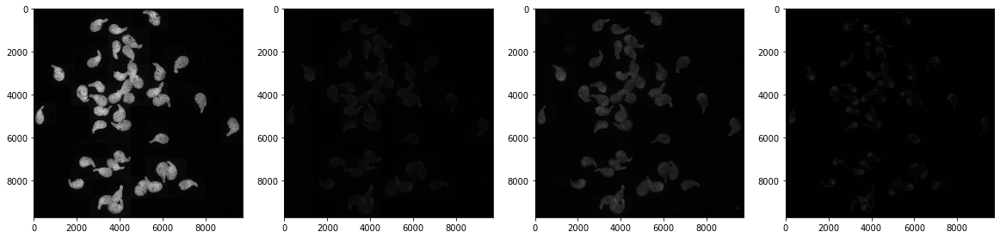

In [5]:
#----------------------------------------------------
# READ THE TIF AND SHOW CHANNELS
#----------------------------------------------------

# i) select the tif that you want to read
# (index "0" is the first one, the only one in the folder in our case )
file_n = 0
# ii) Load the tif file
im = tifffile.imread(tif_files[file_n])


# iii) Set scale of 1px=0.13um (change as required)
x_pixel = 0.13 #-------------------------------------- CHANGE BASED ON YOUR SCALE
y_pixel = 0.13 #-------------------------------------- CHANGE BASED ON YOUR SCALE


# iv) extract number of channels, width and height of the image
channels = np.shape(im)[0]
width = np.shape(im)[1]
height = np.shape(im)[2]
# v) display number of channels, width and height of the image
print('There are %d channels'%channels)
#print('The image is %d px wide'%width)
#print('The image is %d px high'%height)
# vi) plot each channel separately
plt.figure(figsize=[20,8])
plt.subplot(141)
plt.imshow(im[0],cmap='gray')
plt.subplot(142)
plt.imshow(im[1],cmap='gray')
plt.subplot(143)
plt.imshow(im[2],cmap='gray')
plt.subplot(144)
plt.imshow(im[3],cmap='gray')

#----------------------------------------------------
# INITIALISE THE DATAFRAME THAT WILL HOST ALL DATA
#----------------------------------------------------

# i) create an empty "roi" column, which will host the id of each roi (1, 2, 3..)
data_sample = pd.DataFrame({"roi":[]})
# ii) create an empty "x" column, which will host the x position along the AP axis, of each intensity measured
data_x = pd.DataFrame({"x":[]})
# iii) create an empty "y" column for each channel except DAPI, which will host intensity values measured
data_y = pd.DataFrame({})
for i in range(channels):
    if i == 0 : ## to avoid plotting the first channel (DAPI, normalised to 1)
        i== i+1 
    else: ##i.e. for all other channels
        data_y[i] = []
        
# iv) compile the final empty data frame with all columns created
data_collated = pd.concat([data_sample, data_x, data_y], axis=1)

In [6]:
#----------------------------------------------------
# SET CHANNEL LABELS
#----------------------------------------------------
# i) ask for label of fist channel
ch1_label = input("What is in Channel 01? ")
# ii) ask for label of second channel
ch2_label = input("What is in Channel 02? ")
# iii) ask for label of third channel
ch3_label = input("What is in Channel 03? ")
# iv) ask for label of fourth channel
ch4_label = input("What is in Channel 04? ")

What is in Channel 01? DAPI
What is in Channel 02? Pax9
What is in Channel 03? Sox17
What is in Channel 04? FoxA2


<br/>

Running the __cell below__ will allow to set the width of the analysis window (in some way, the thickness of the area around the line ROI that will be considered for analysis). The higher the number, the smoother the result, but the longer it will take.

In [7]:
#----------------------------------------------------
# SET PIXEL WIDTH
#----------------------------------------------------
# i) ask for pixel width
N = input("Please select the total pixel width you want to consider (e.g. 400): ")
# ii) print confirmation message
print("*** The analysis will be done over a "+N+"px width ***")
# iii) convert into number format
N= int(N)

Please select the total pixel width you want to consider (e.g. 400): 400
*** The analysis will be done over a 400px width ***


#### 3. Quantification
Time to start the quantification and let the script run! The code will loop across every ROI (i.e. sample) loaded, and will:
- extract the coordinates of the nodes traced in each ROI, and fill the line in with additional points
- within the band considered for analysis, maps each point of the mask to its appropriate position along the line ROI (see image)
- record the signal intensity measured, for each channel
- plot these values (raw), plot them normalised to DAPI intensity (normalised) 
- start building a scatterplot with data points from every sample (summary scatterplot)
<br/>

![](Gastruloid_profiler_Image3.jpg)

All output plots, are automatically saved in the __Output__ folder

100%|██████████| 4/4 [02:43<00:00, 40.81s/it]


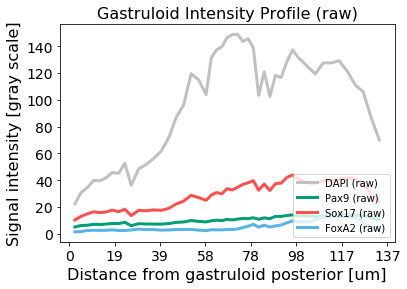

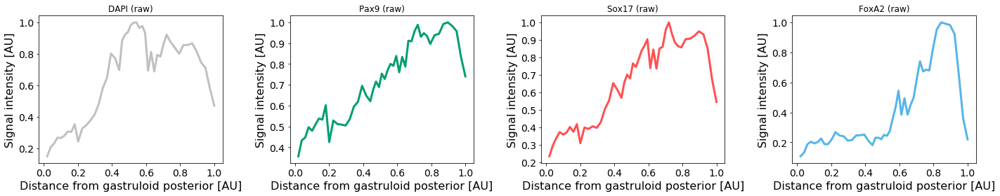

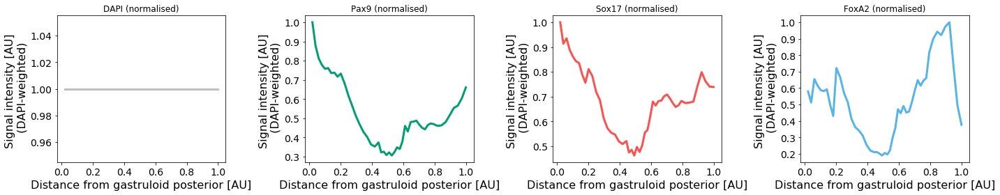

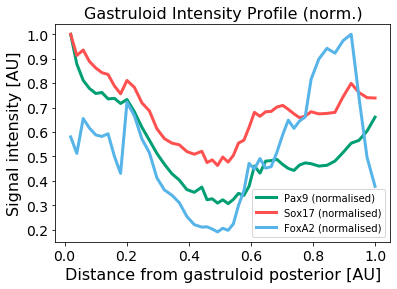

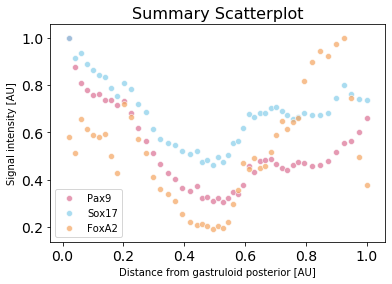

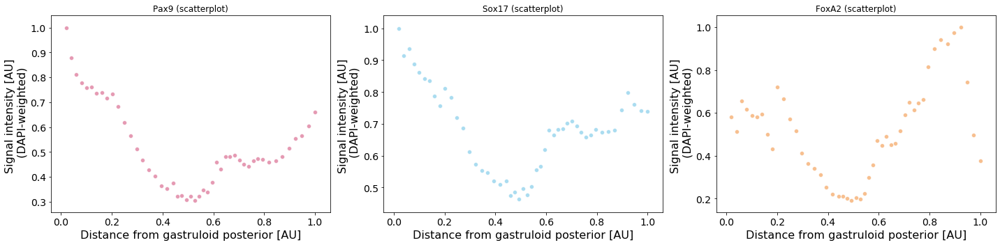

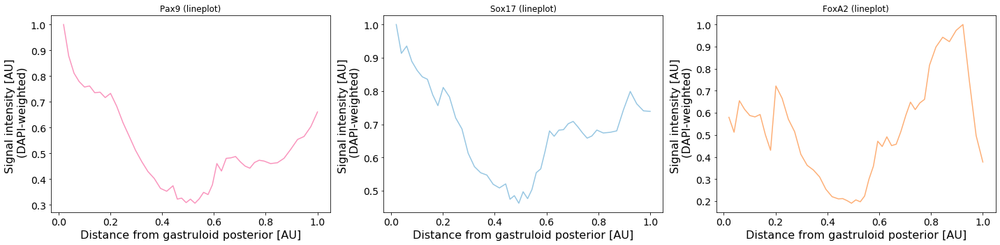

100%|██████████| 4/4 [02:41<00:00, 40.47s/it]


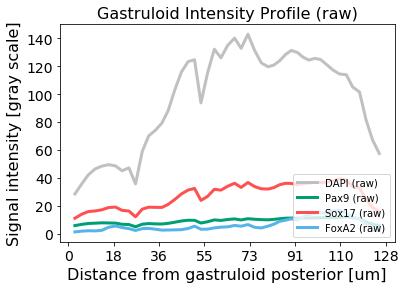

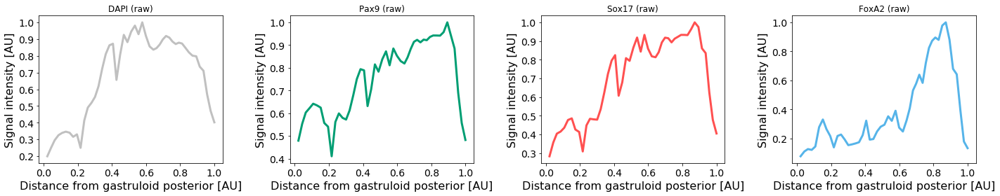

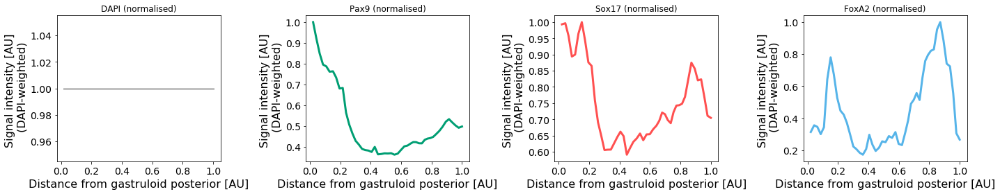

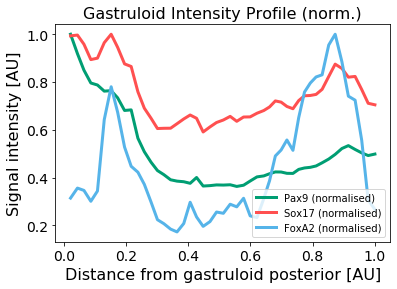

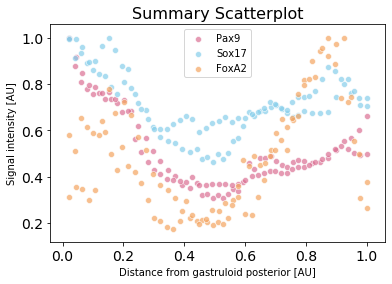

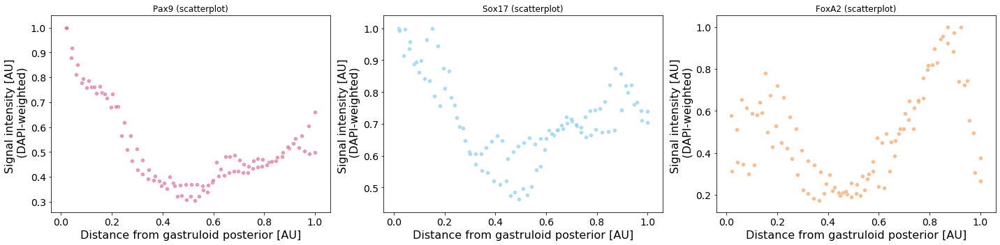

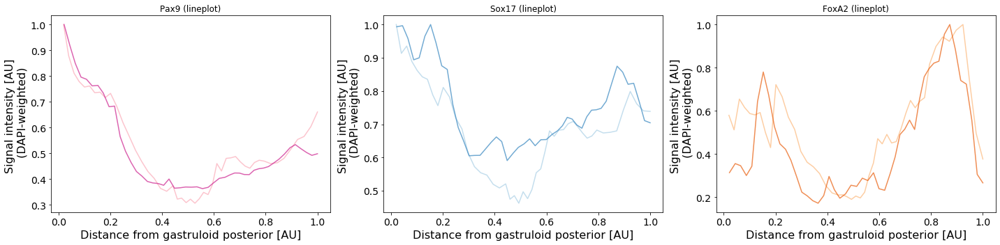

100%|██████████| 4/4 [02:32<00:00, 38.17s/it]


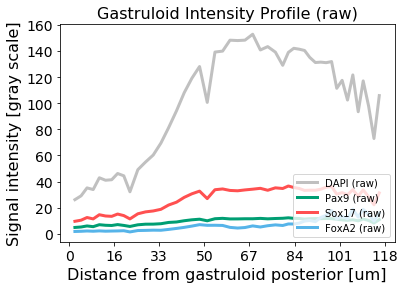

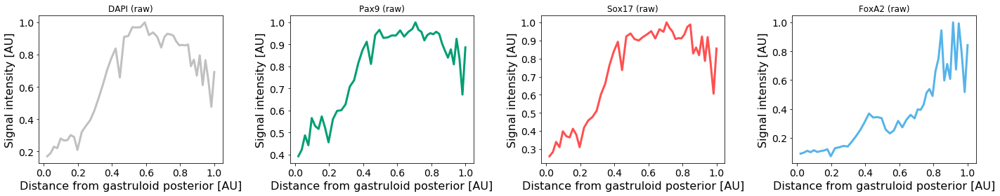

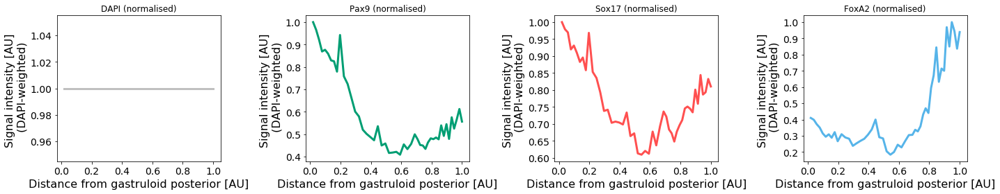

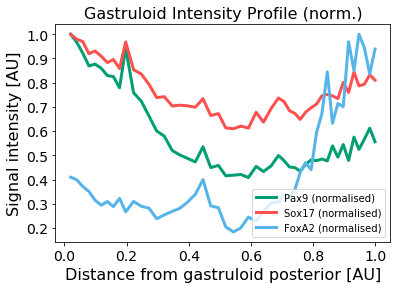

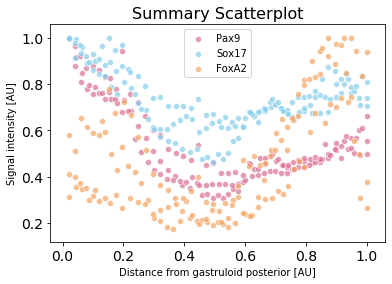

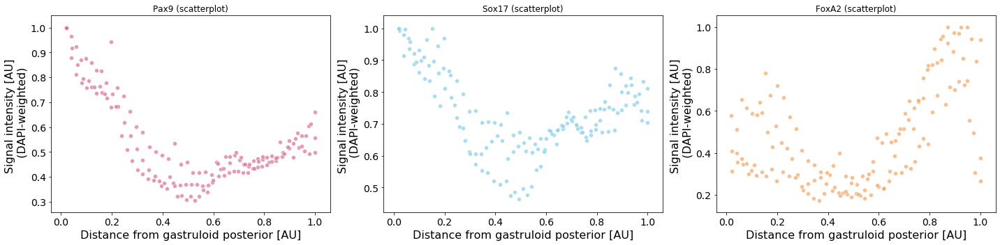

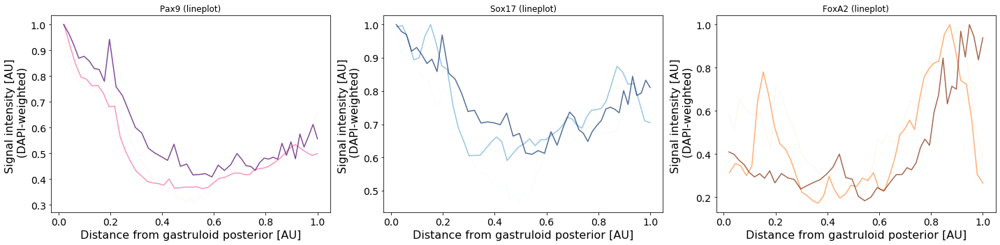

100%|██████████| 4/4 [02:32<00:00, 38.22s/it]


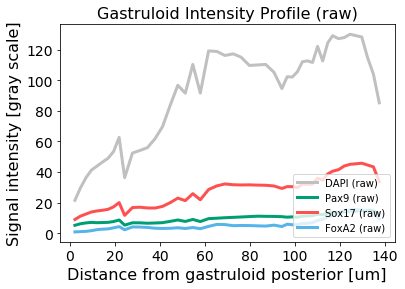

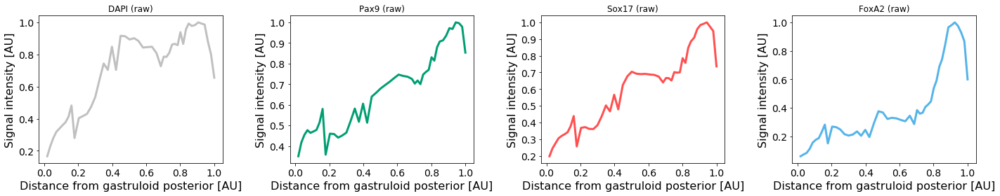

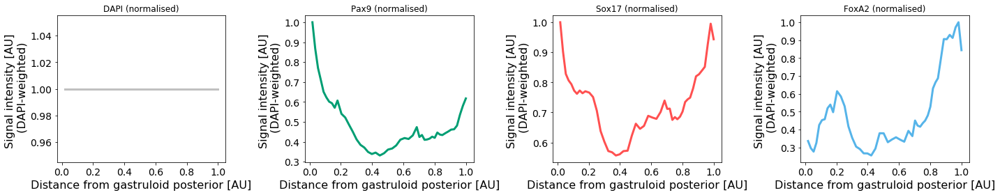

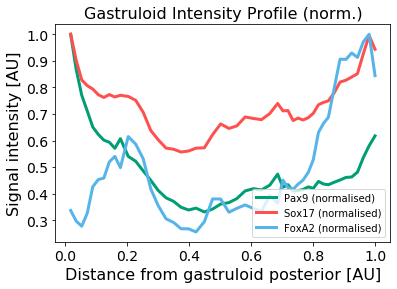

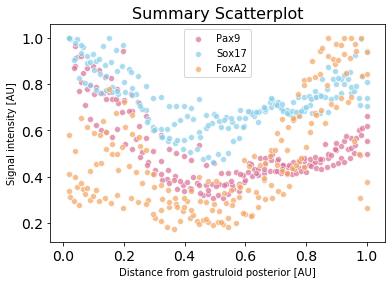

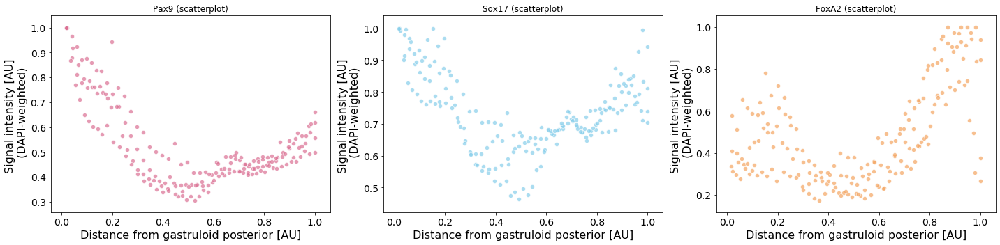

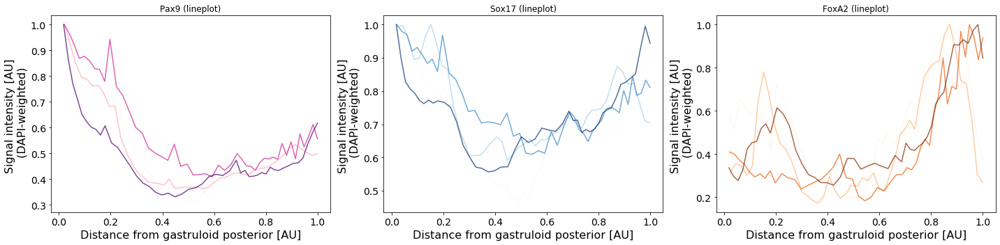

100%|██████████| 4/4 [02:30<00:00, 37.50s/it]


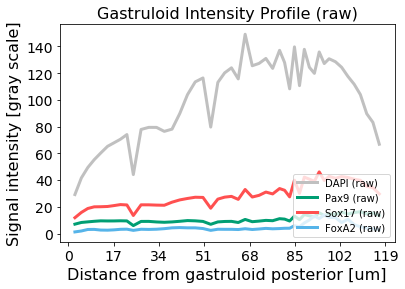

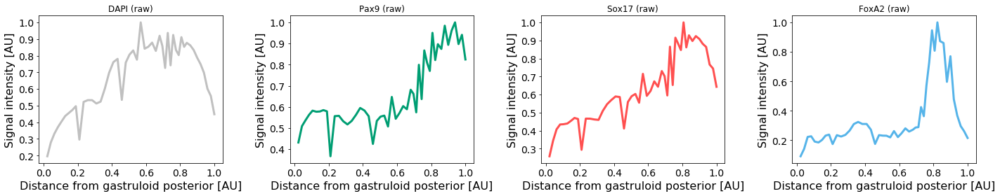

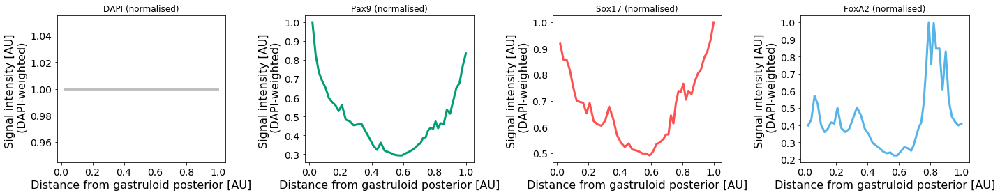

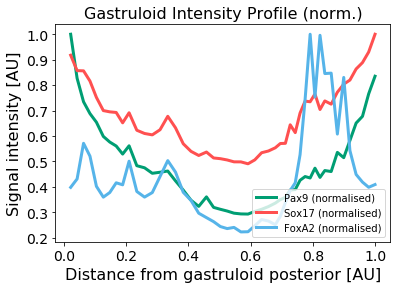

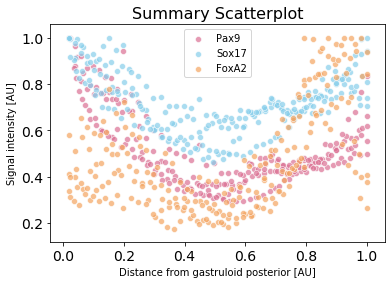

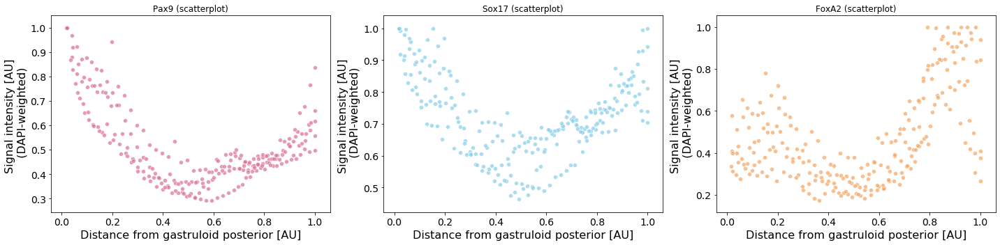

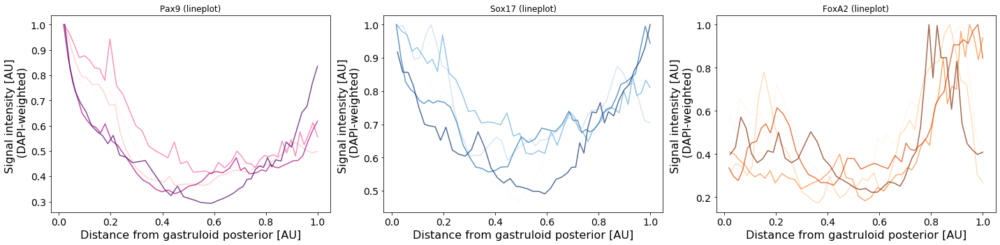

100%|██████████| 4/4 [02:30<00:00, 37.66s/it]


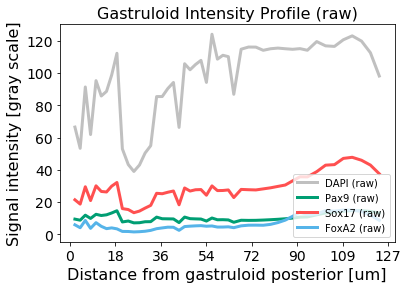

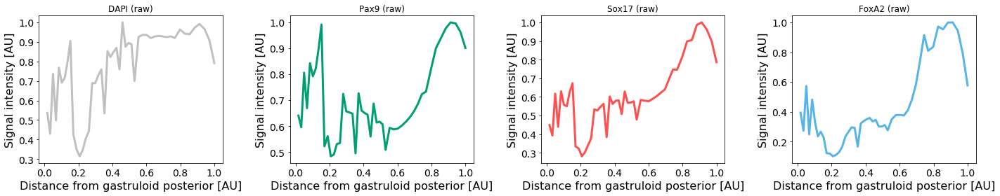

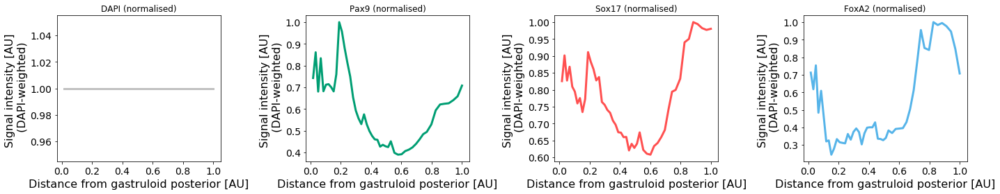

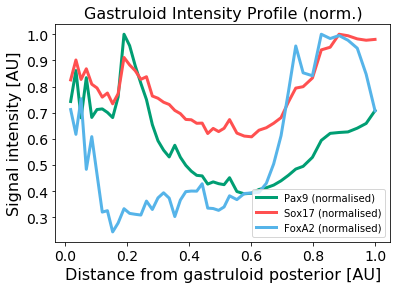

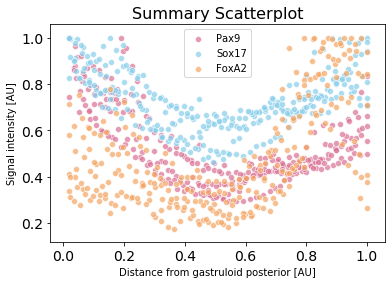

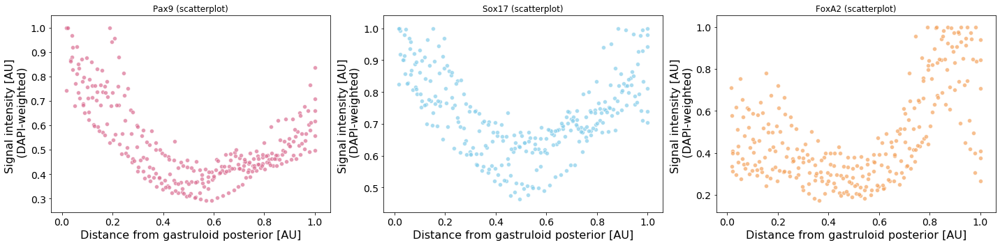

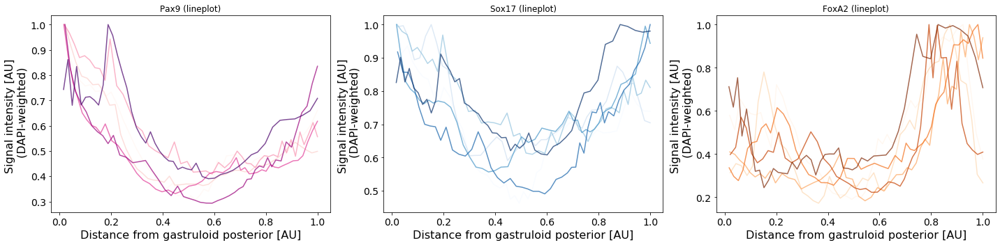

100%|██████████| 4/4 [02:29<00:00, 37.28s/it]


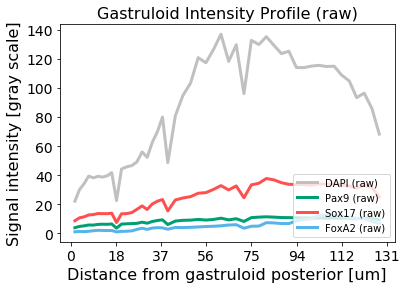

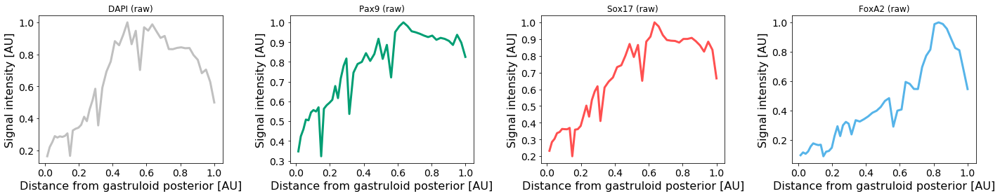

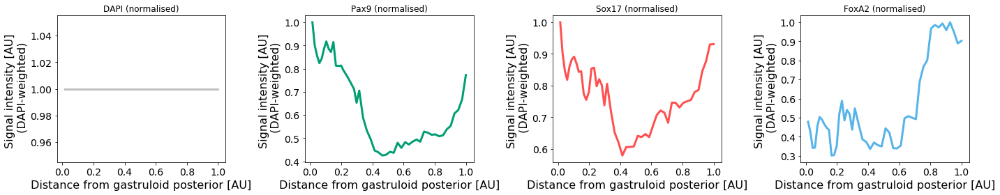

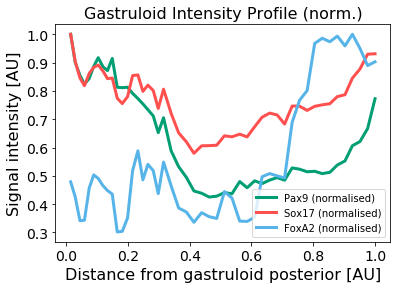

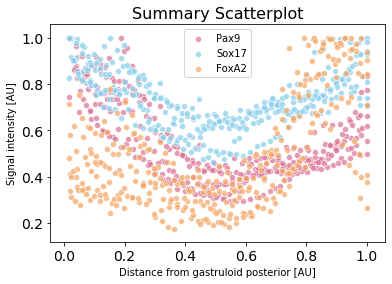

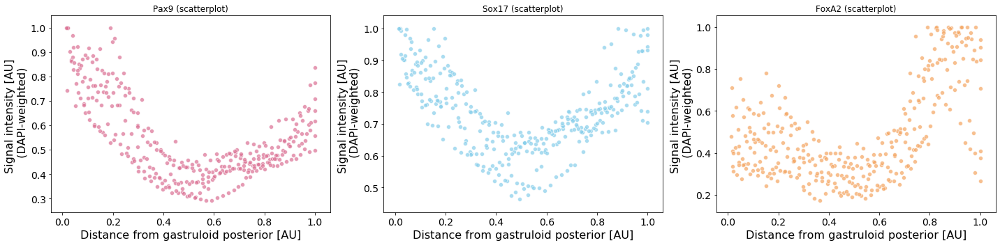

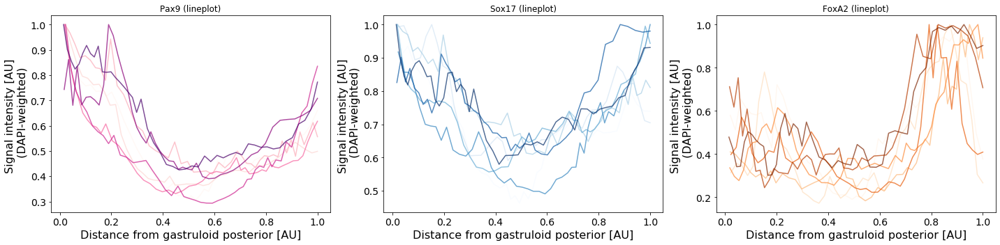

100%|██████████| 4/4 [02:28<00:00, 37.07s/it]


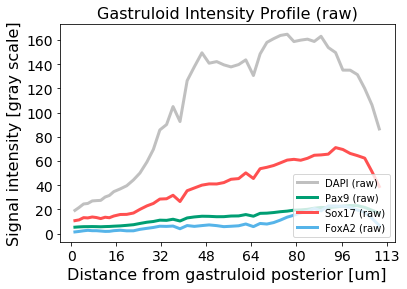

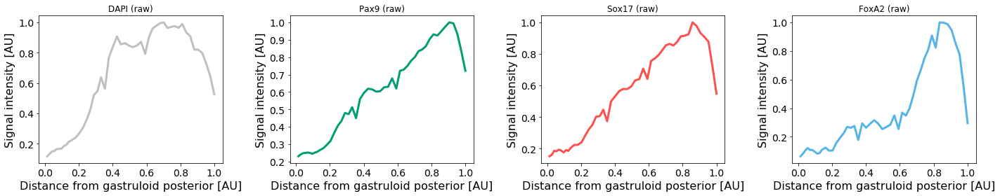

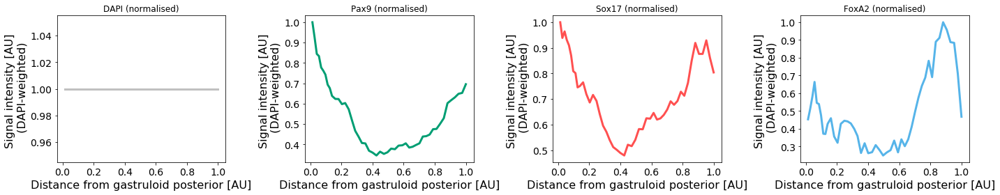

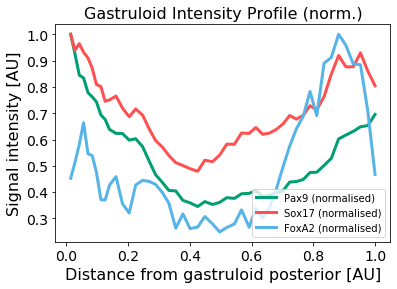

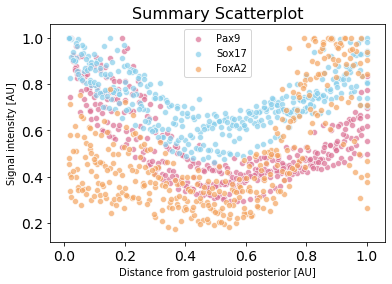

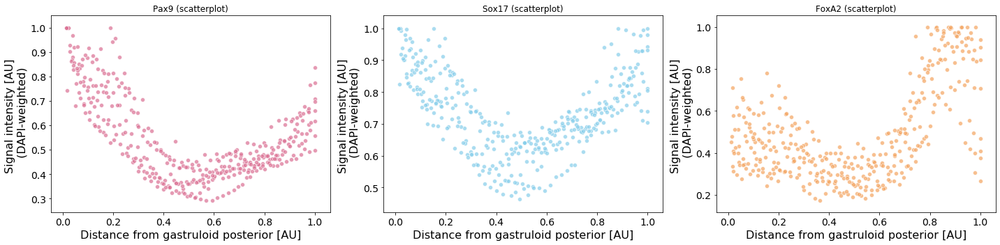

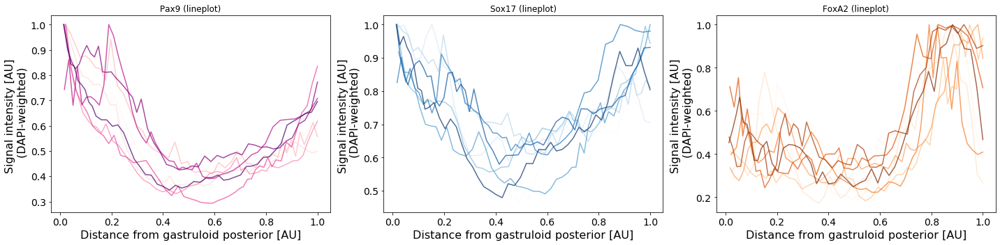

100%|██████████| 4/4 [02:26<00:00, 36.72s/it]


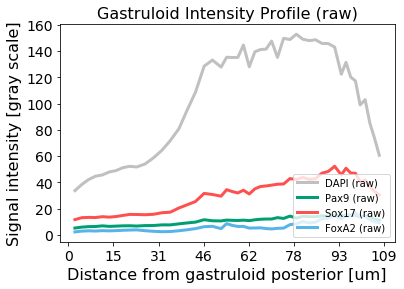

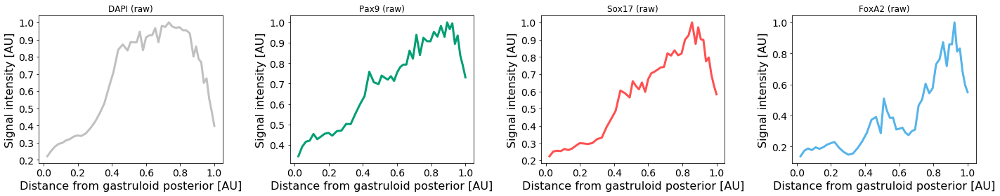

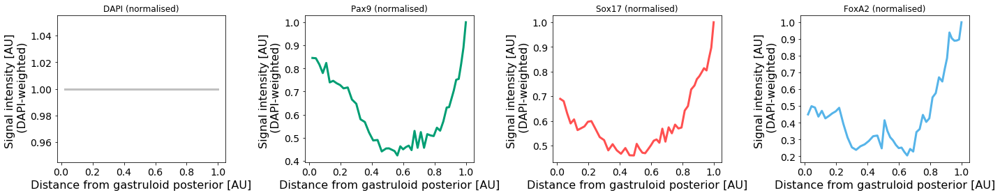

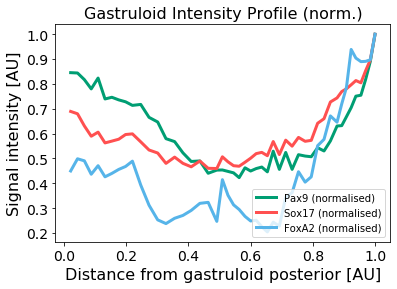

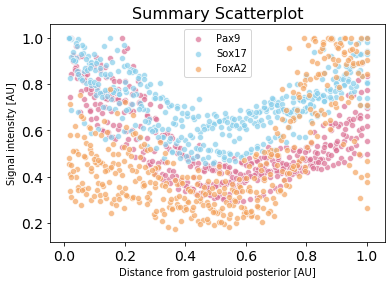

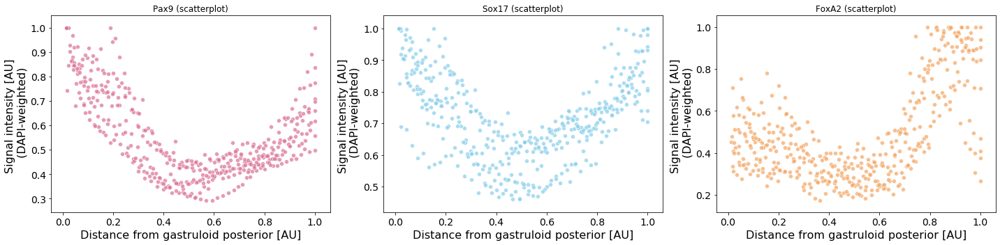

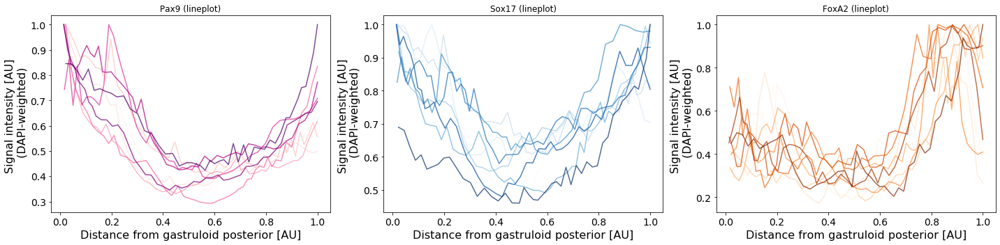

100%|██████████| 4/4 [02:27<00:00, 36.80s/it]


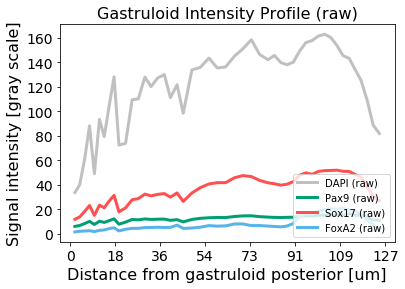

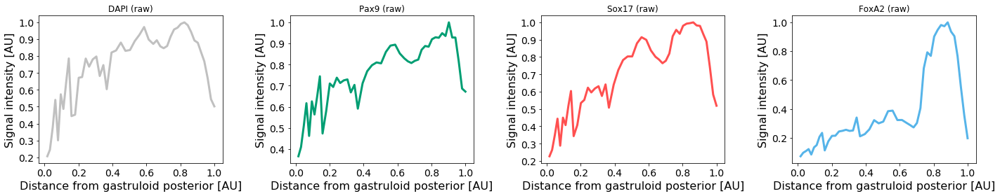

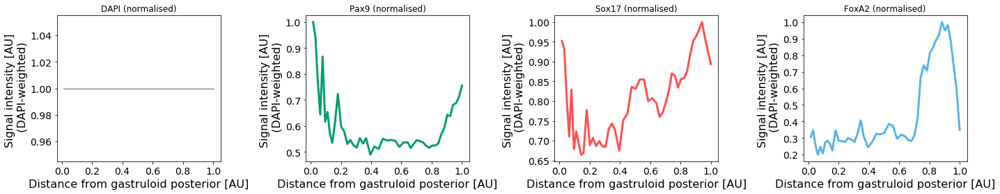

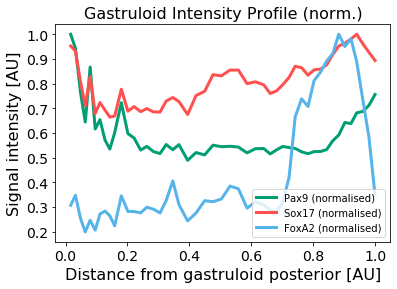

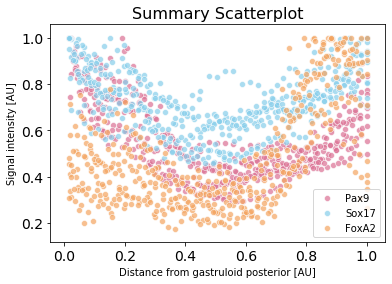

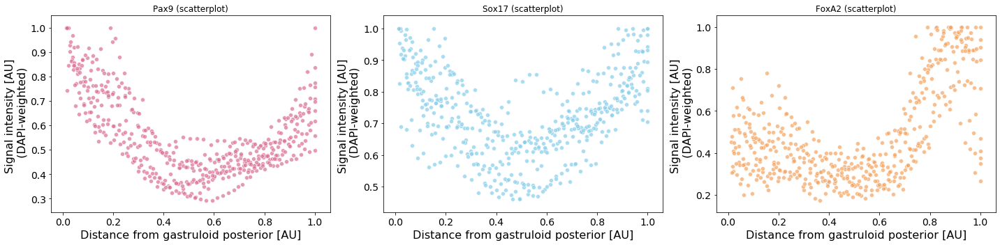

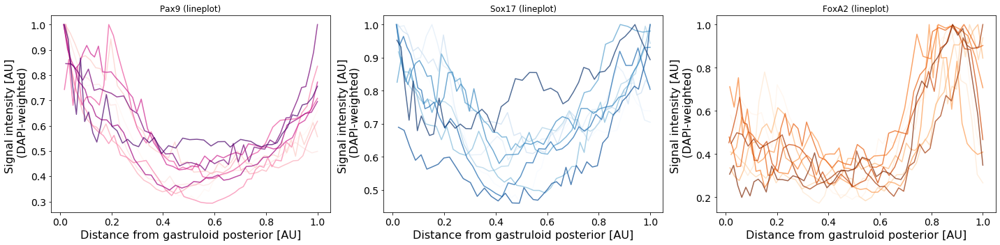

100%|██████████| 4/4 [02:26<00:00, 36.62s/it]


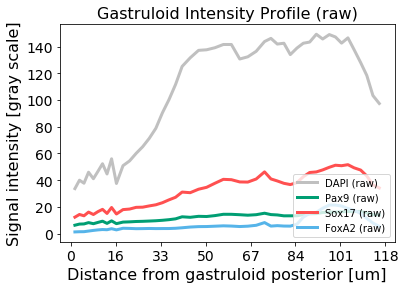

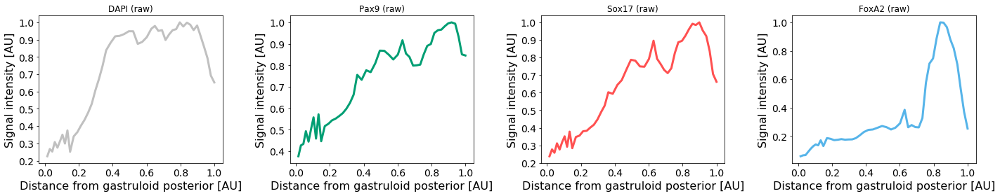

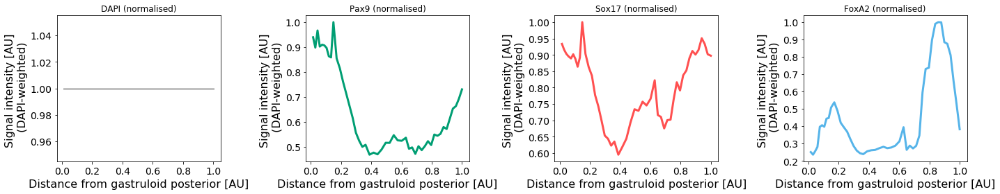

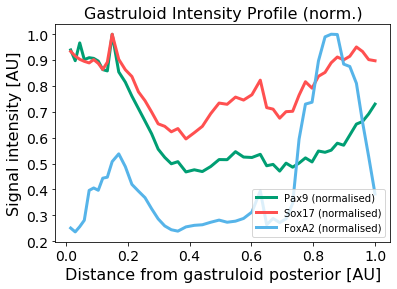

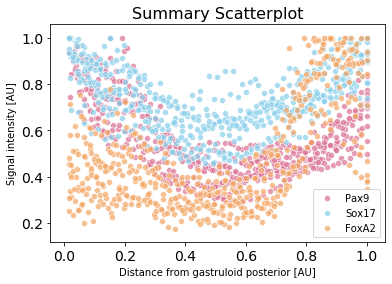

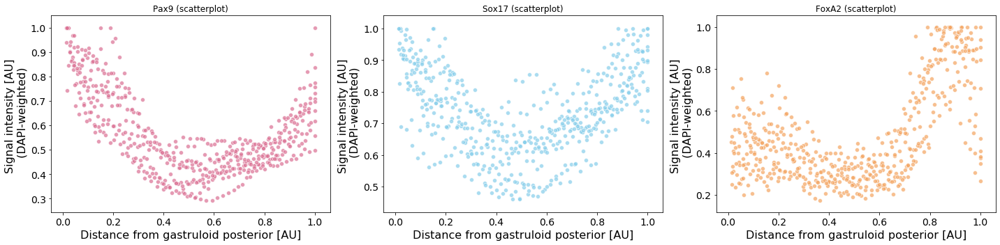

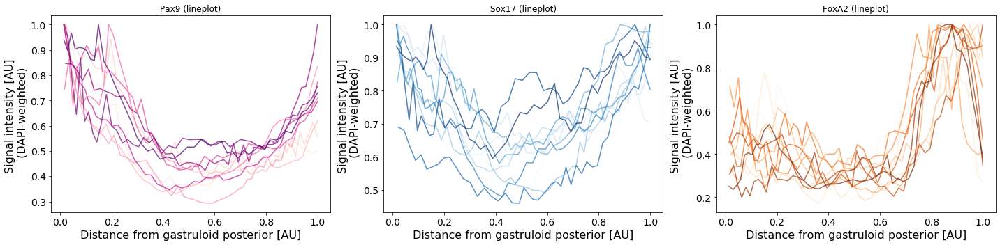

100%|██████████| 4/4 [02:26<00:00, 36.69s/it]


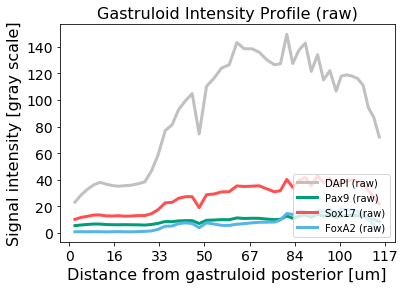

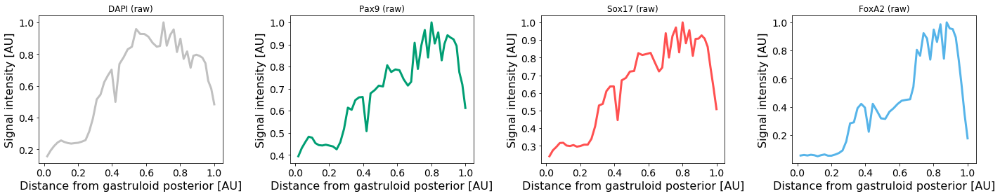

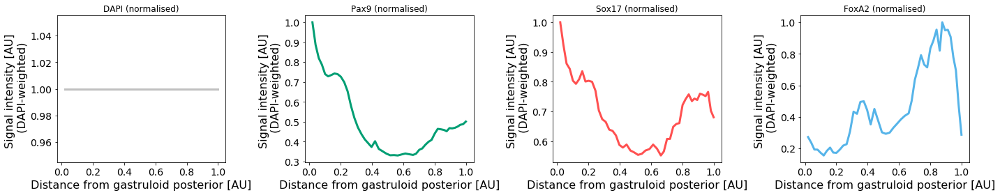

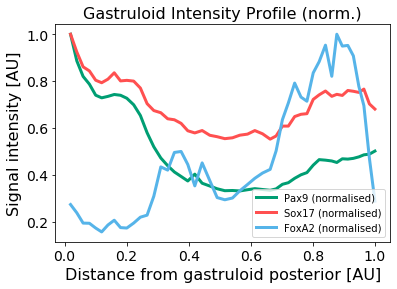

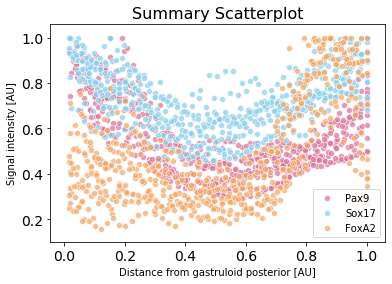

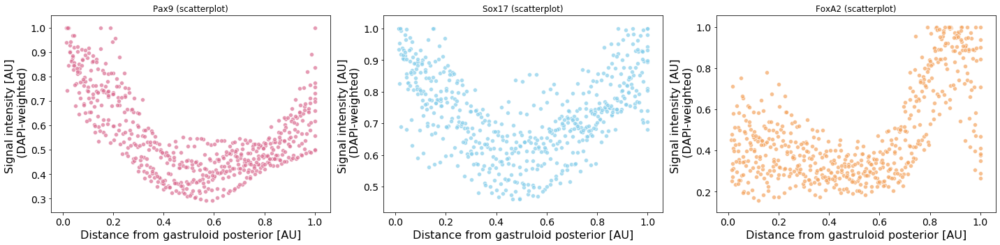

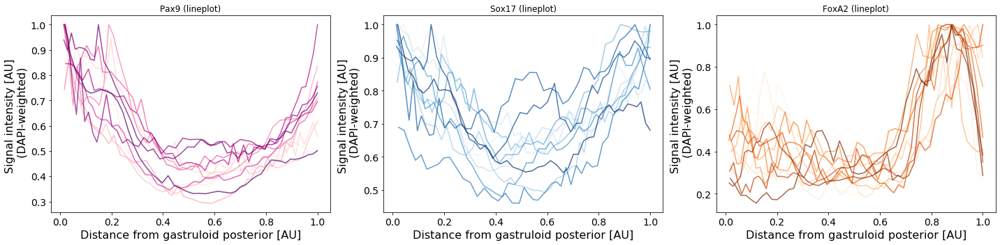

100%|██████████| 4/4 [02:26<00:00, 36.66s/it]


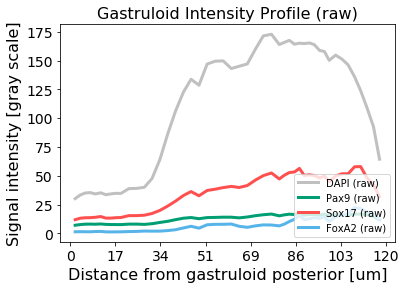

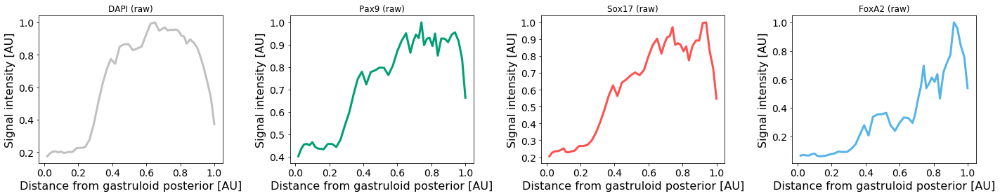

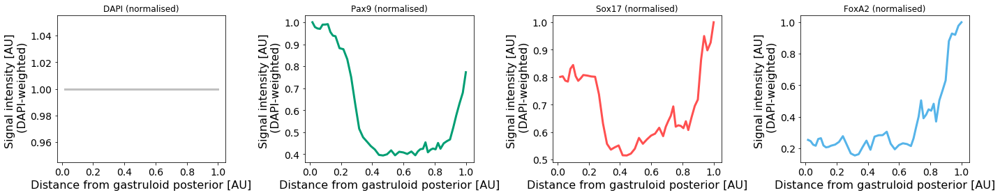

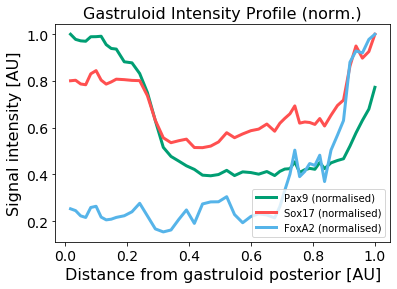

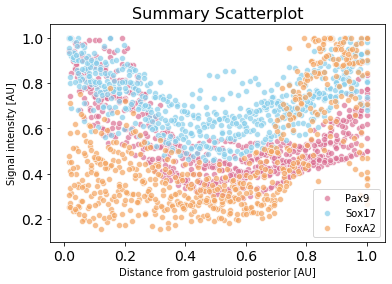

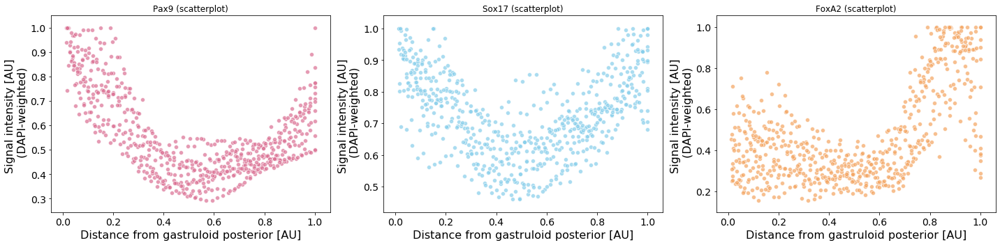

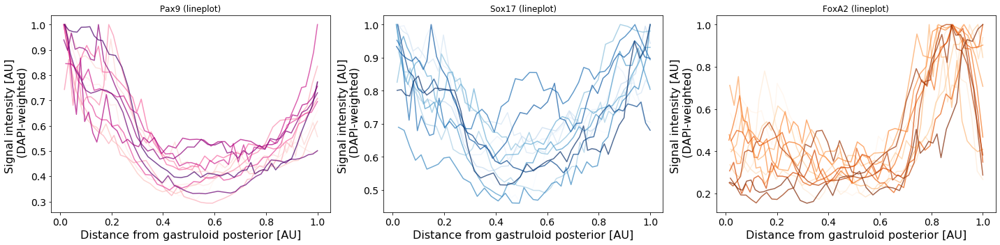

100%|██████████| 4/4 [02:27<00:00, 36.86s/it]


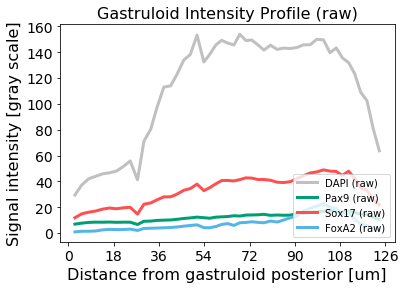

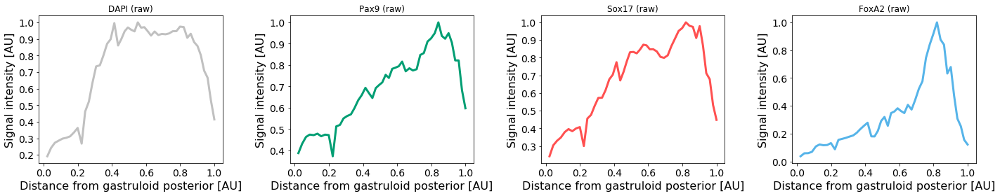

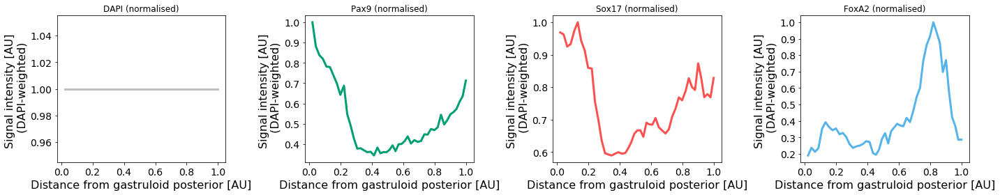

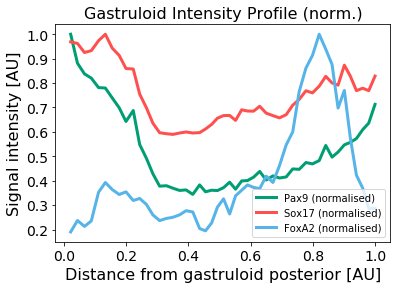

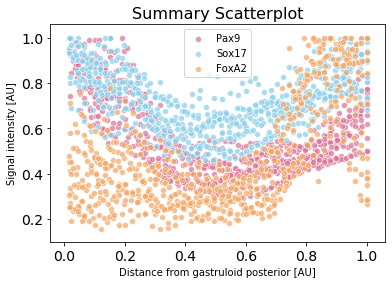

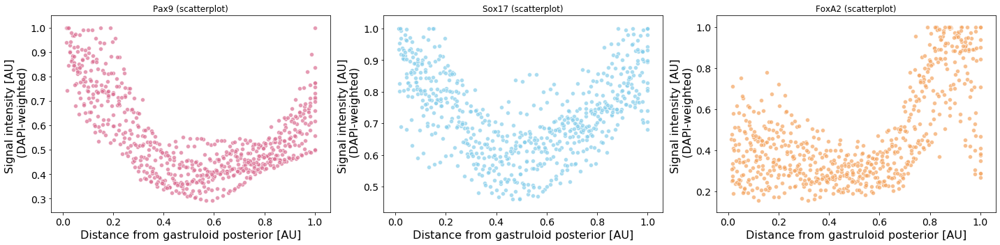

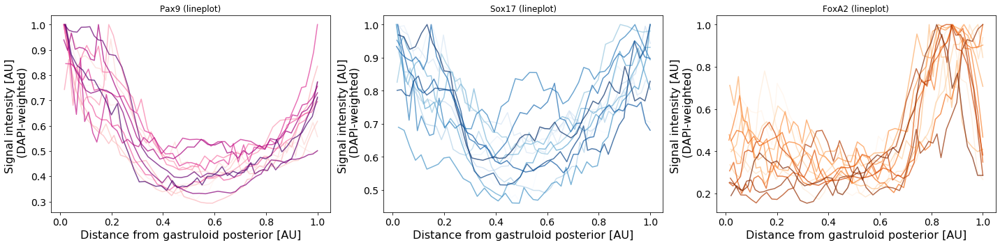

100%|██████████| 4/4 [02:27<00:00, 36.80s/it]


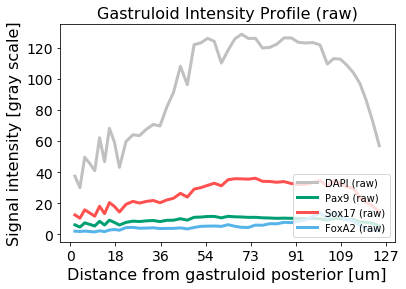

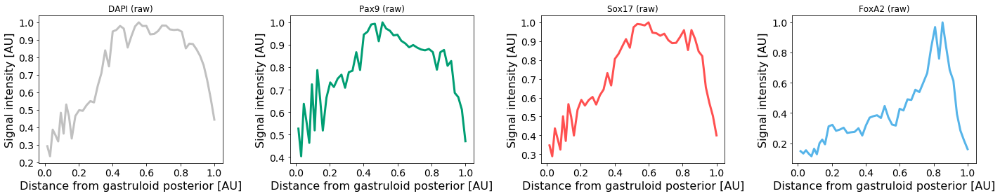

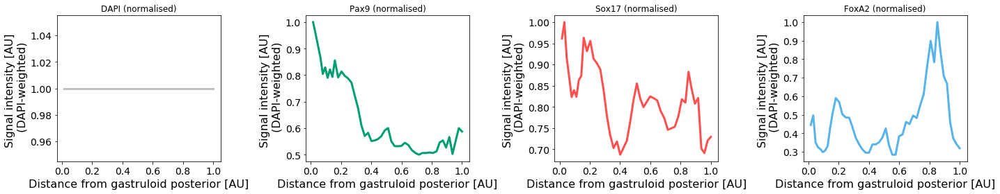

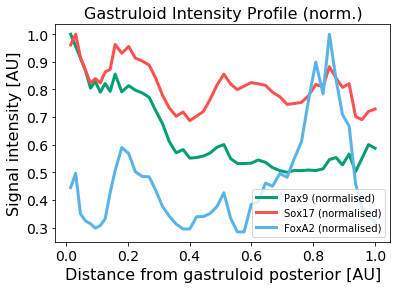

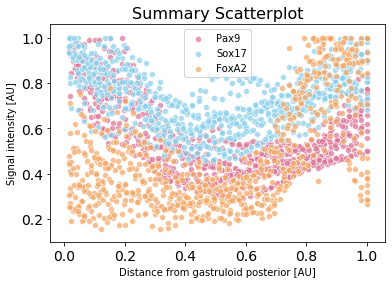

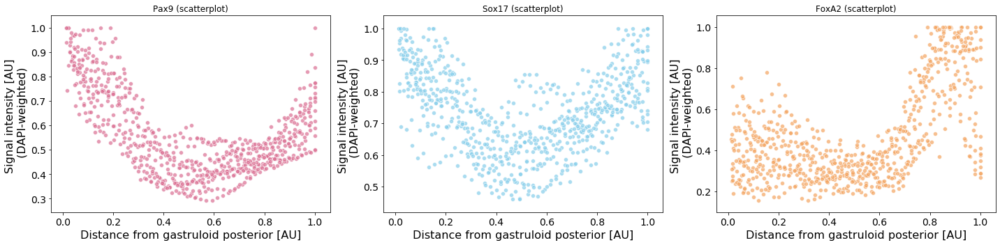

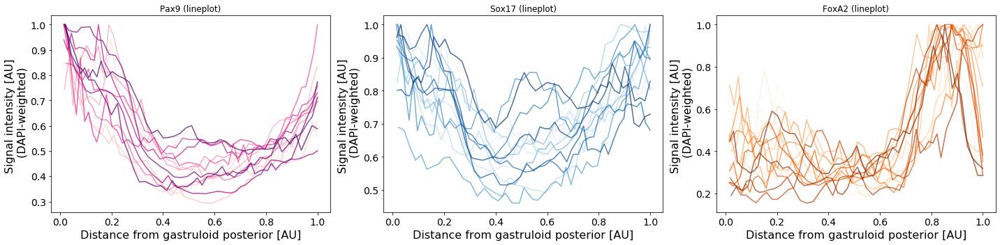

100%|██████████| 4/4 [02:26<00:00, 36.64s/it]


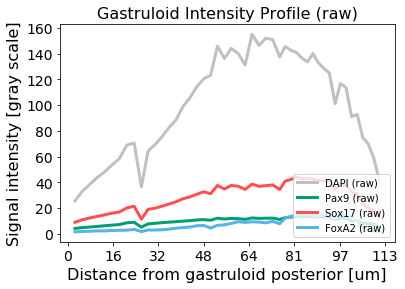

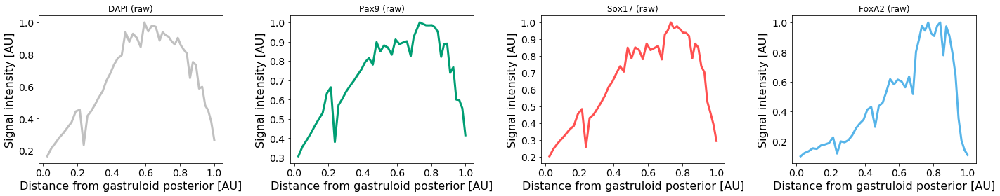

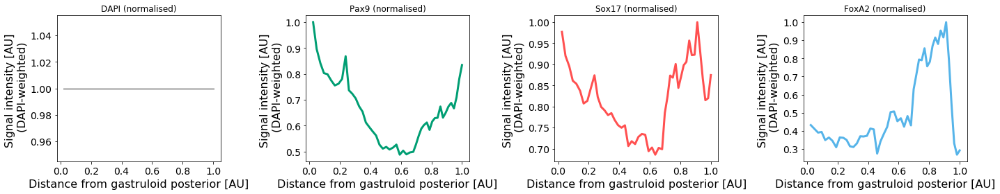

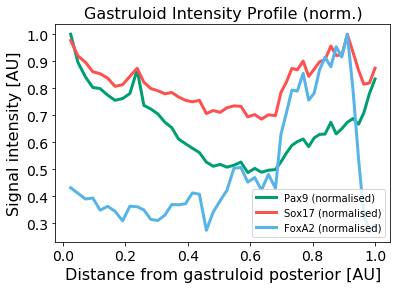

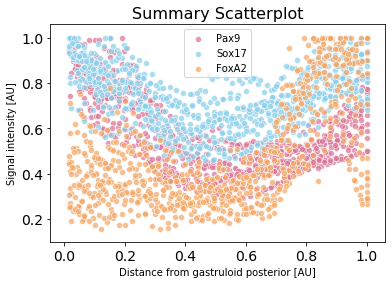

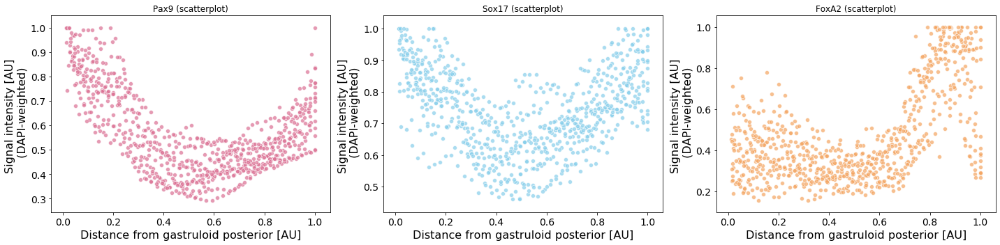

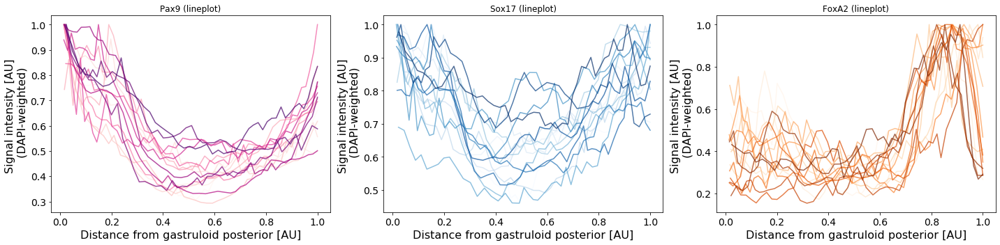

100%|██████████| 4/4 [02:25<00:00, 36.49s/it]


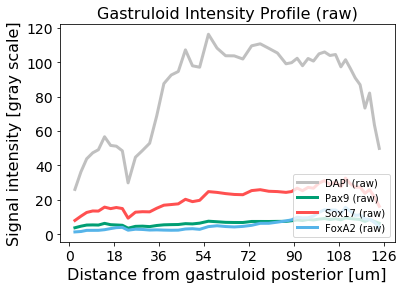

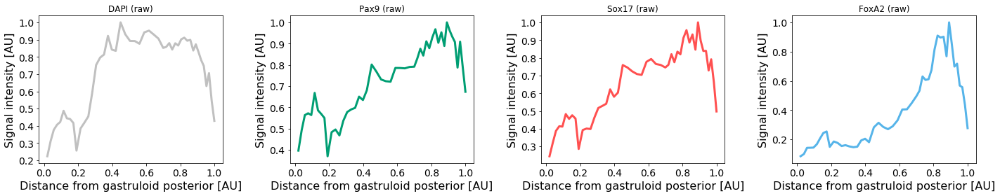

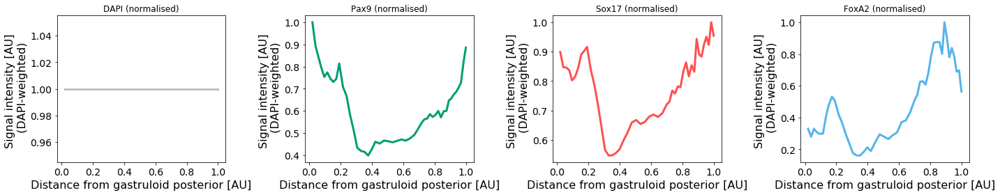

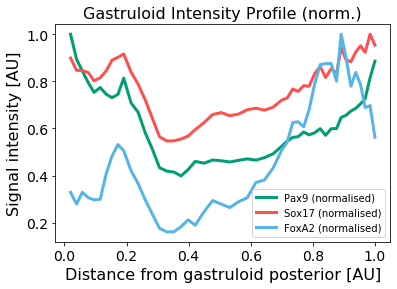

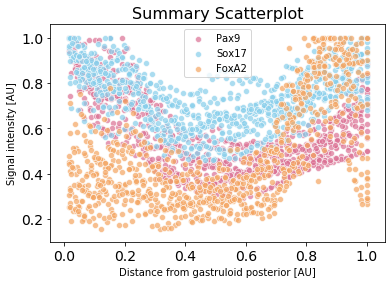

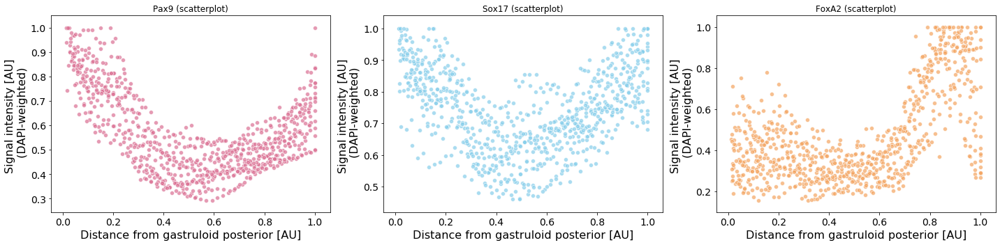

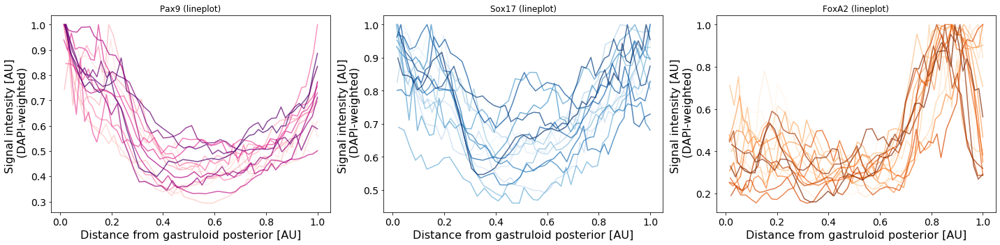

100%|██████████| 4/4 [02:26<00:00, 36.67s/it]


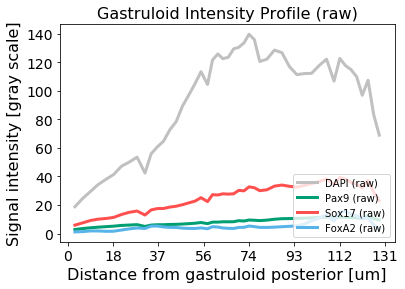

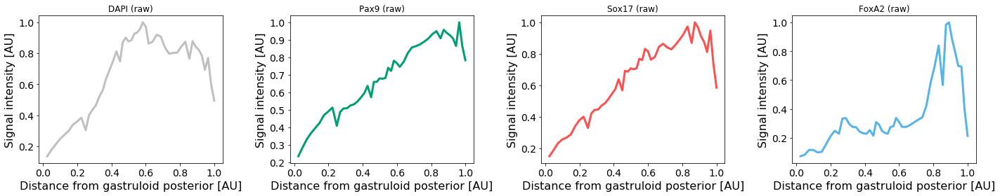

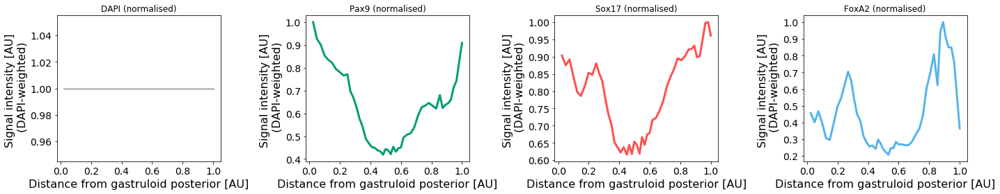

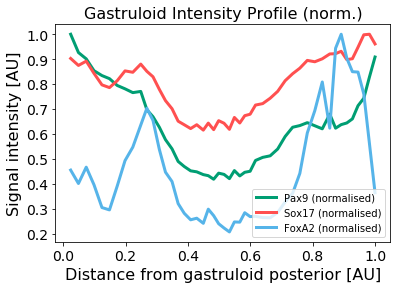

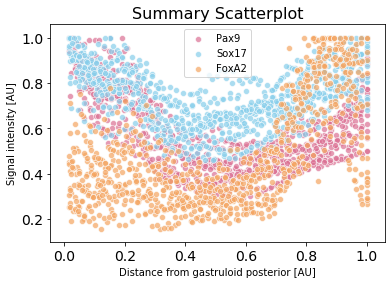

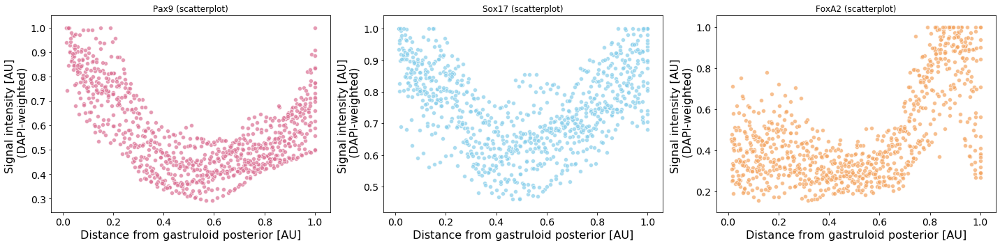

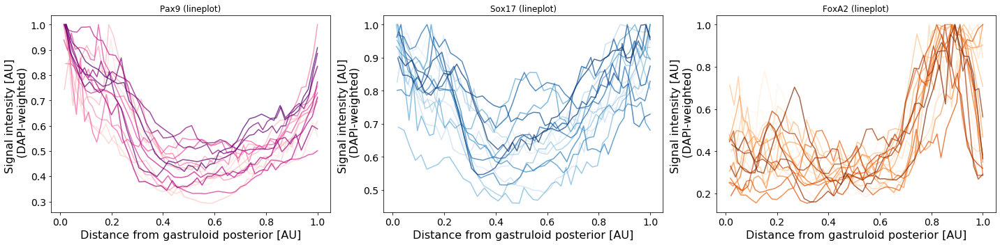

100%|██████████| 4/4 [02:25<00:00, 36.47s/it]


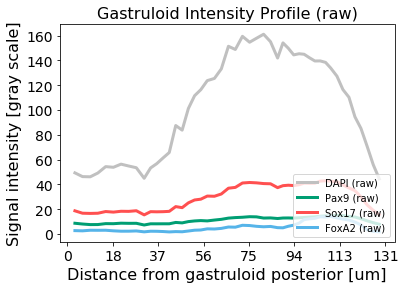

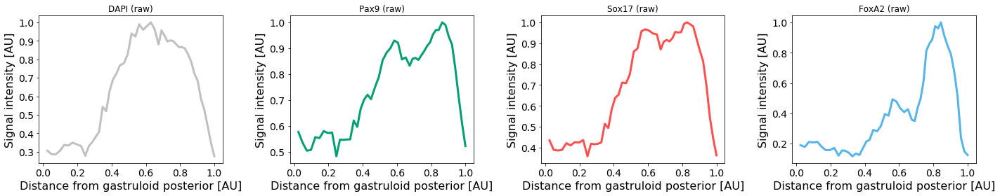

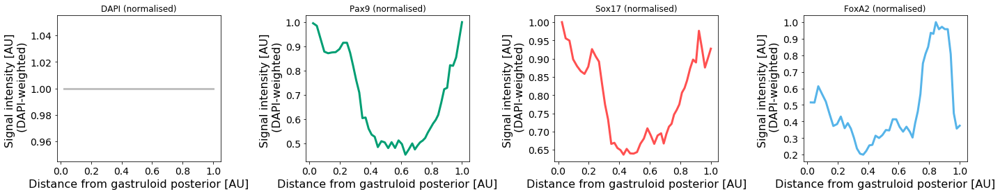

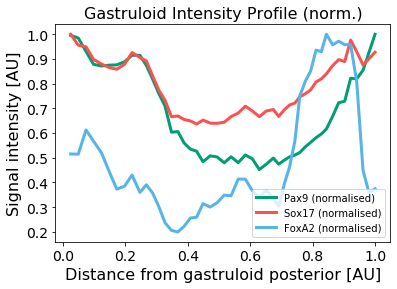

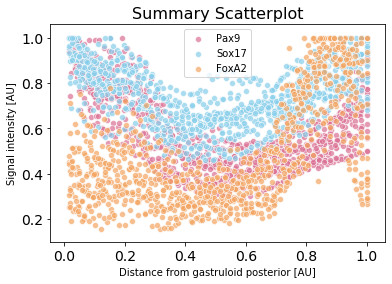

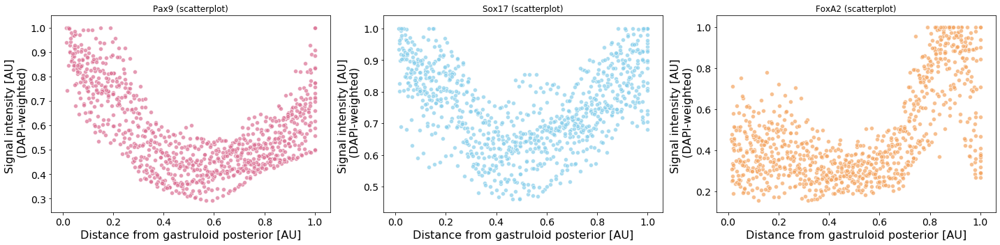

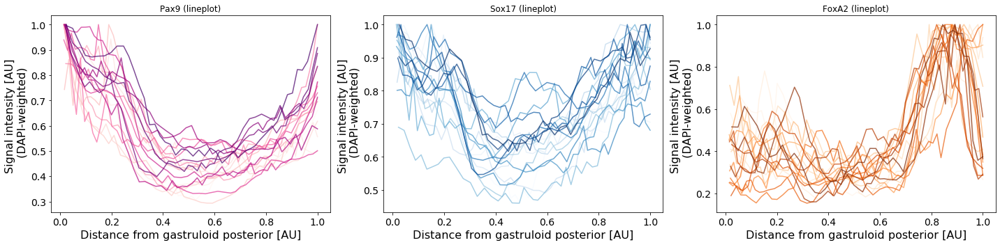

100%|██████████| 4/4 [02:26<00:00, 36.70s/it]


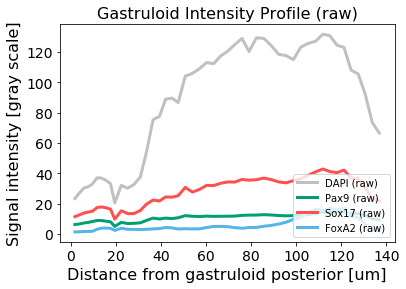

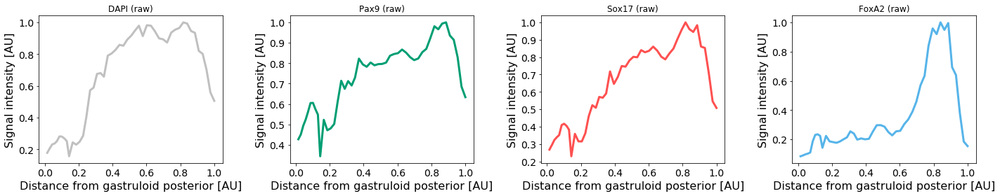

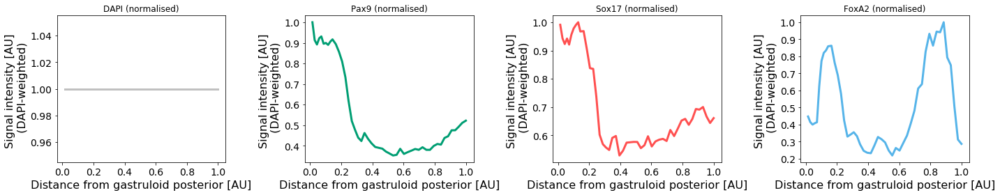

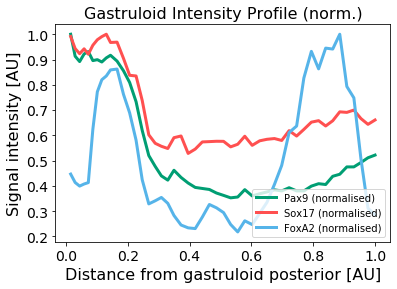

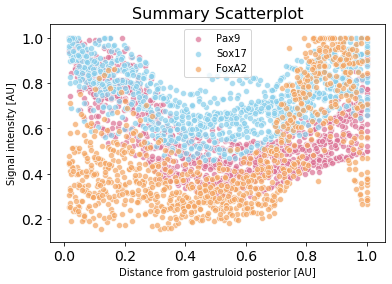

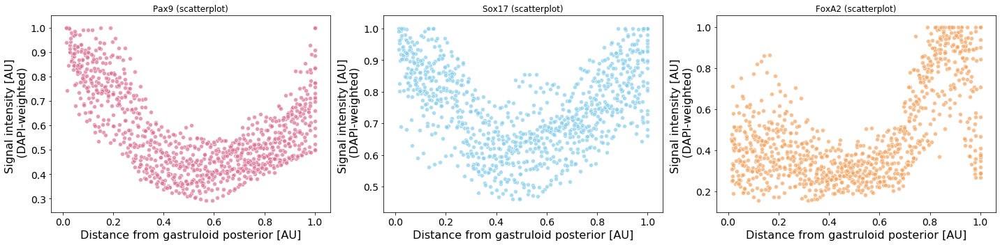

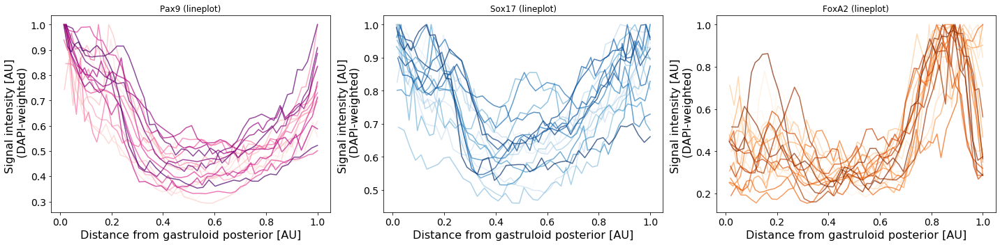

100%|██████████| 4/4 [02:26<00:00, 36.62s/it]


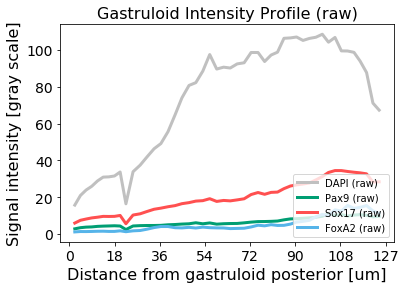

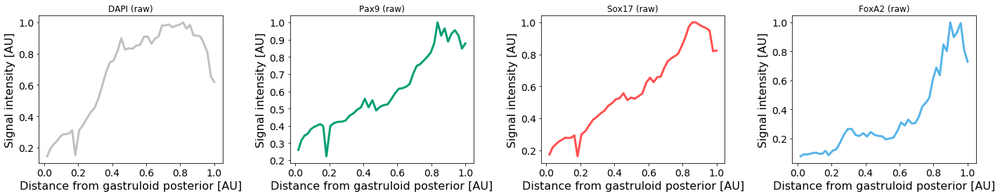

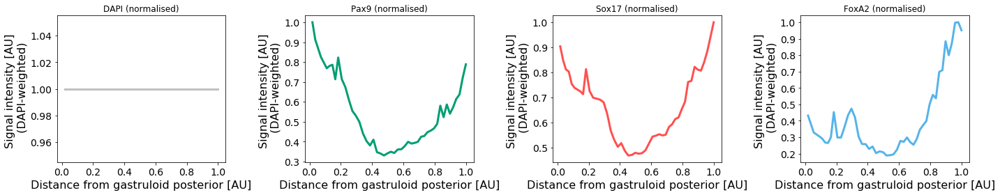

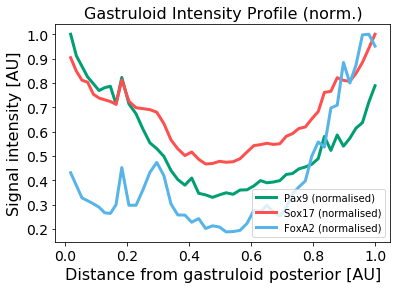

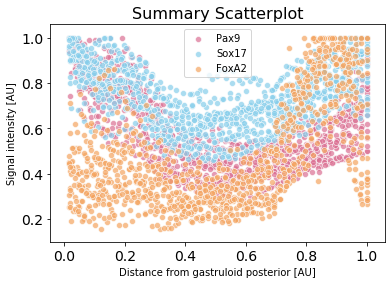

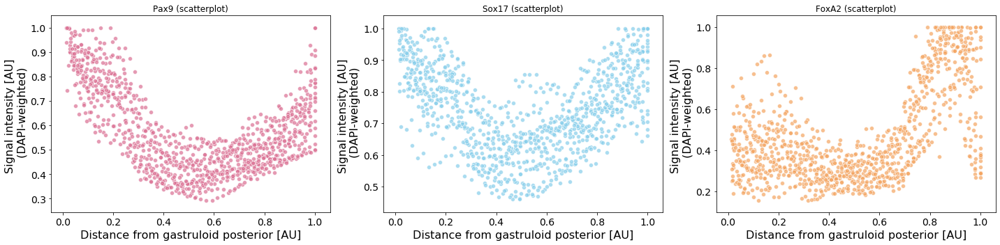

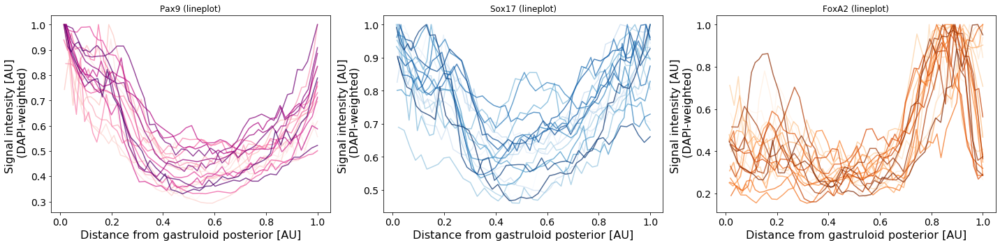

100%|██████████| 4/4 [02:26<00:00, 36.71s/it]


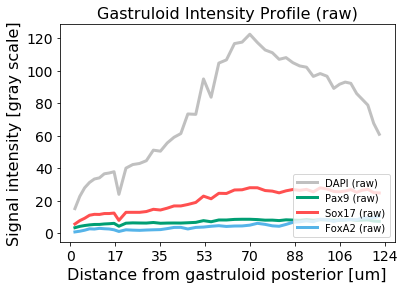

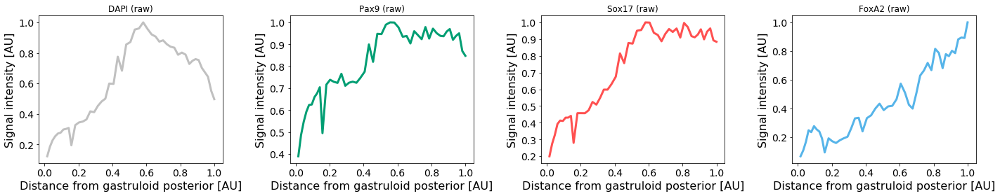

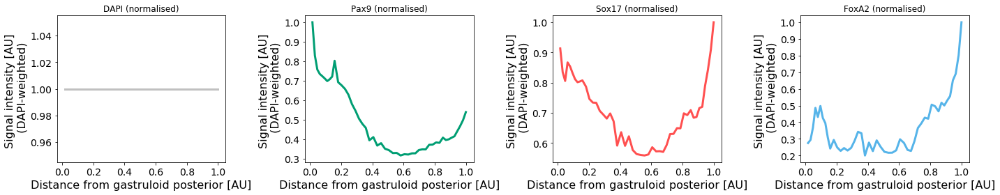

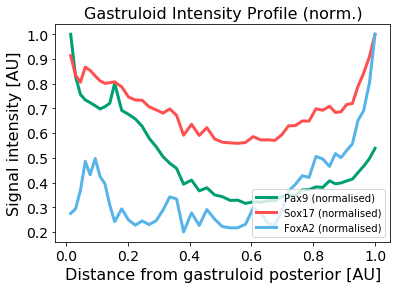

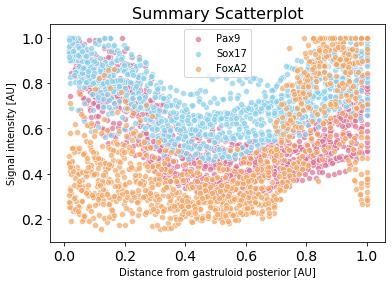

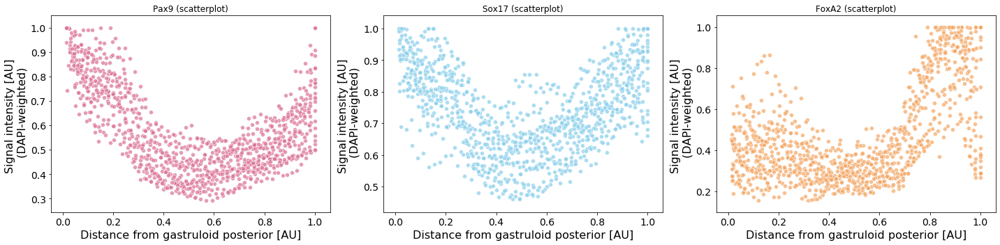

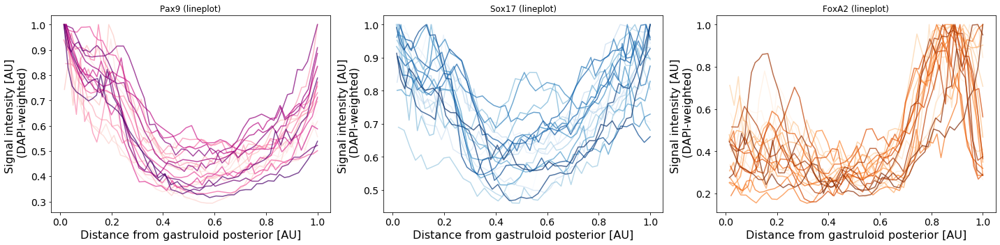

100%|██████████| 4/4 [02:25<00:00, 36.41s/it]


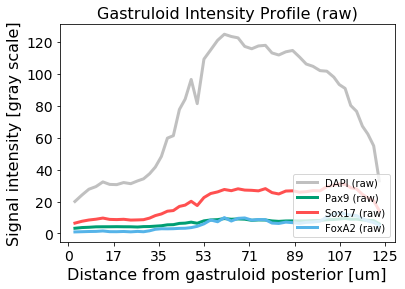

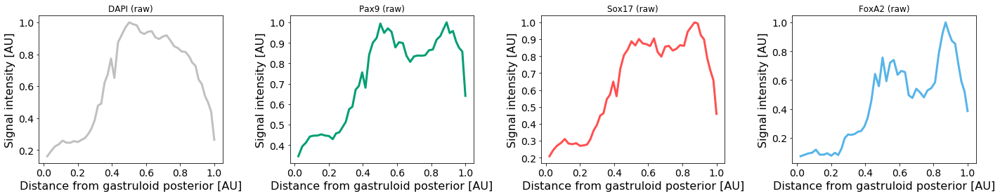

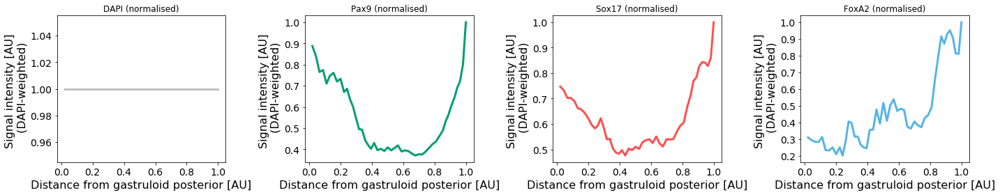

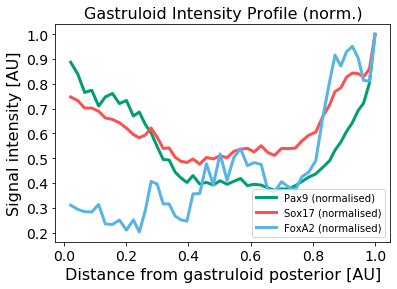

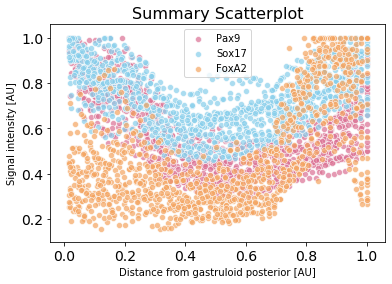

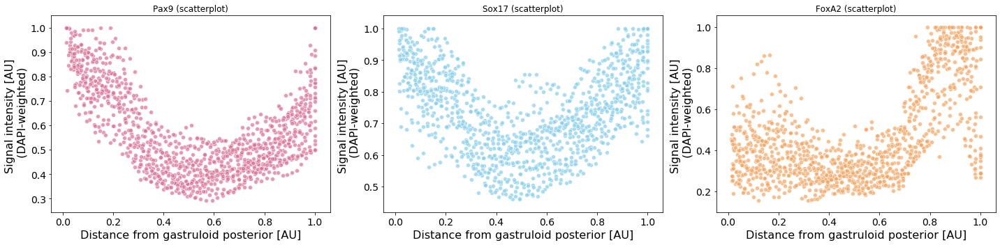

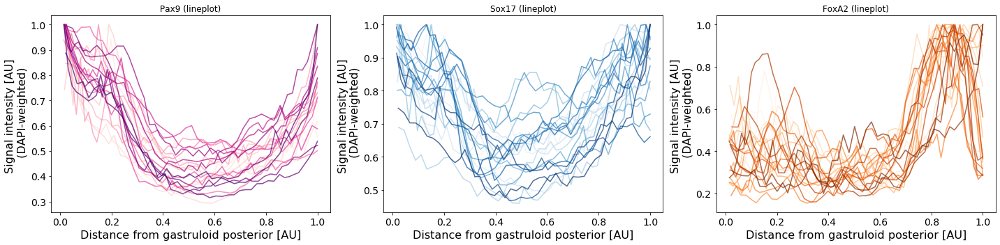

100%|██████████| 4/4 [02:26<00:00, 36.55s/it]


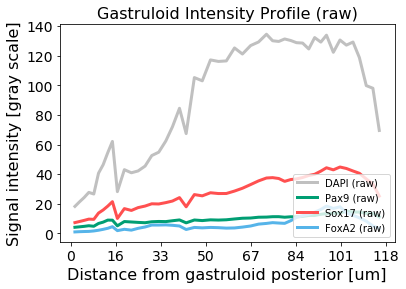

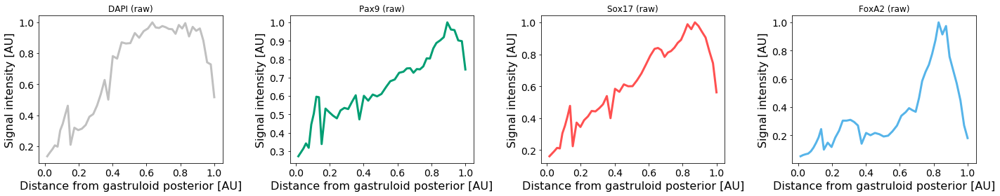

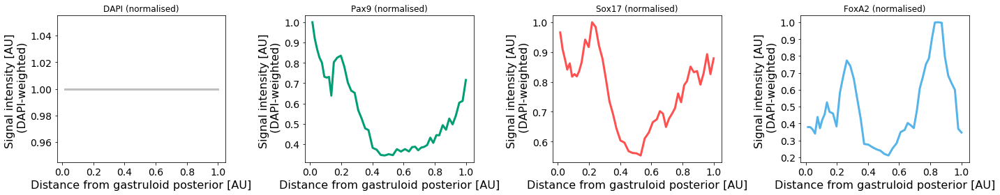

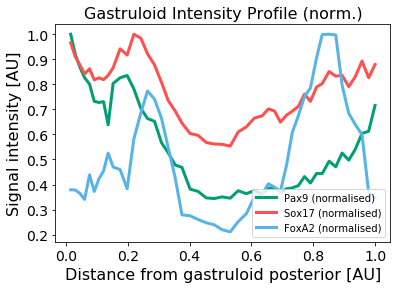

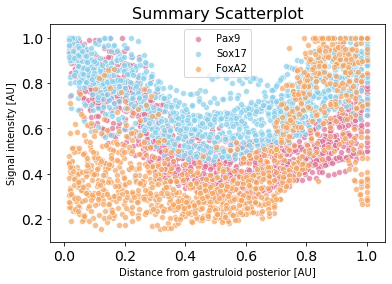

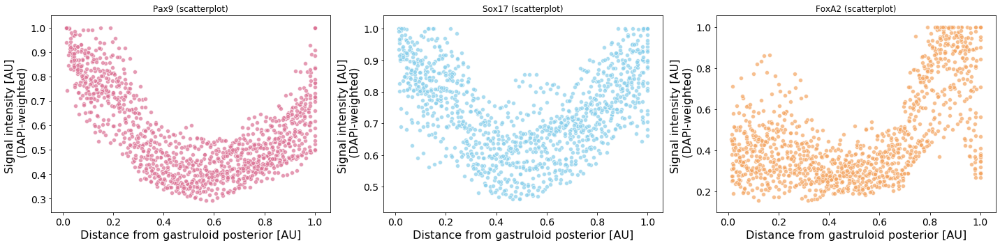

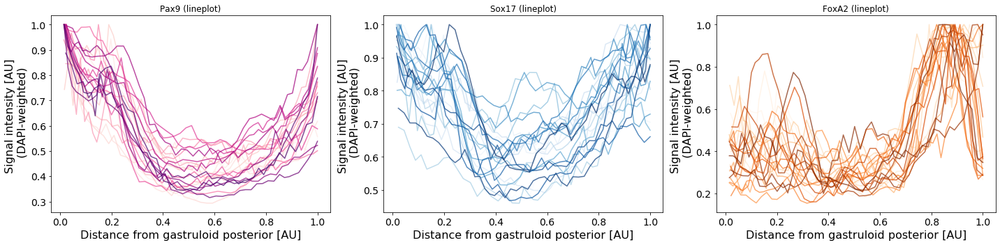

100%|██████████| 4/4 [02:25<00:00, 36.44s/it]


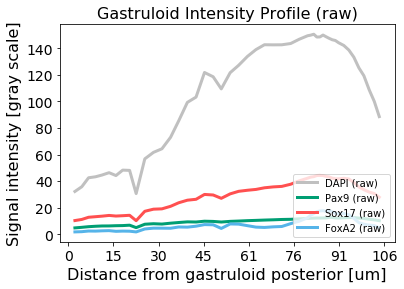

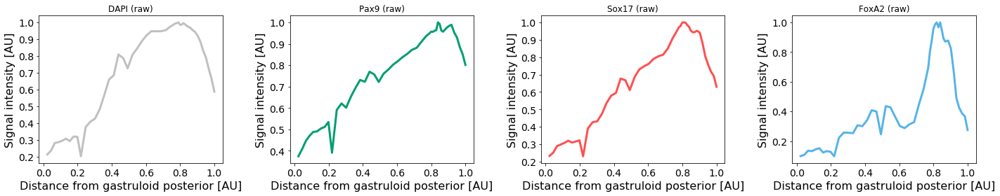

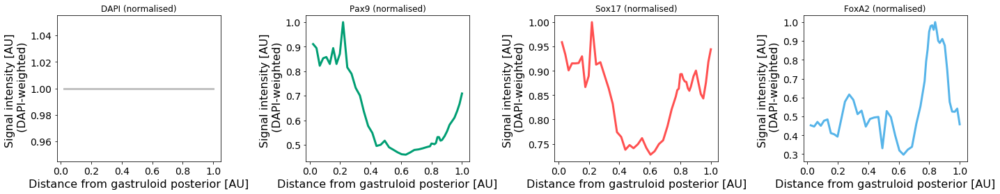

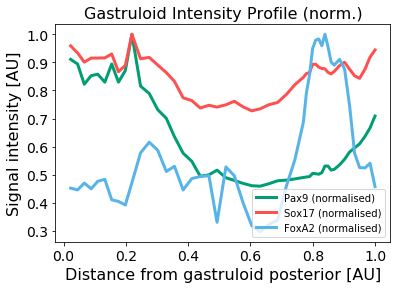

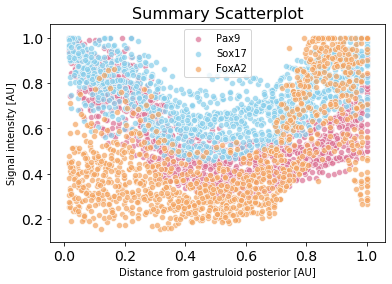

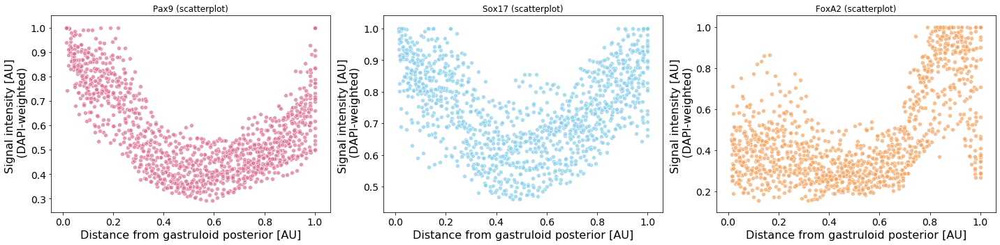

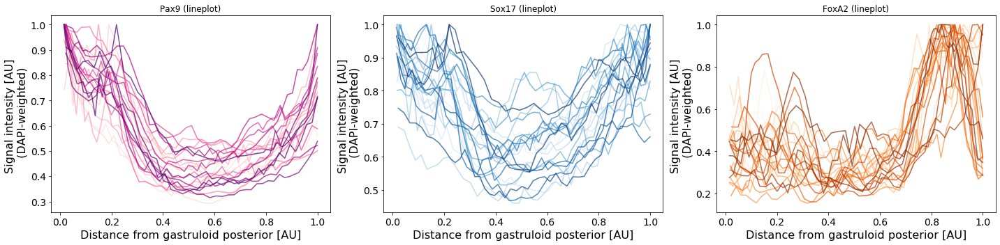

100%|██████████| 4/4 [02:26<00:00, 36.65s/it]


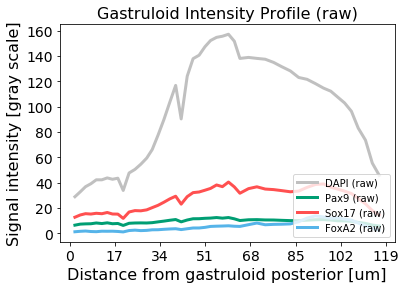

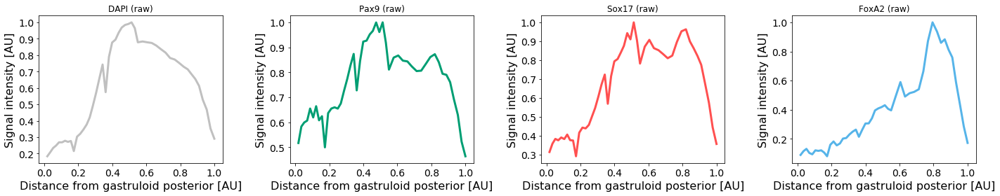

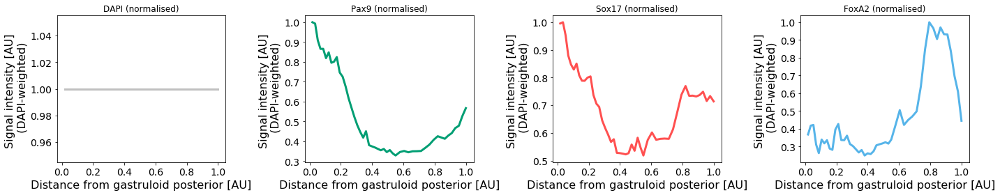

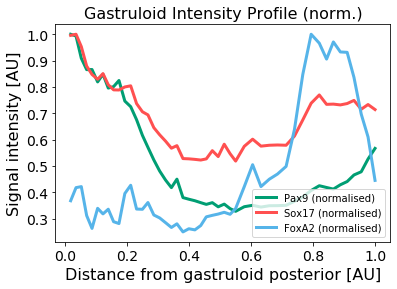

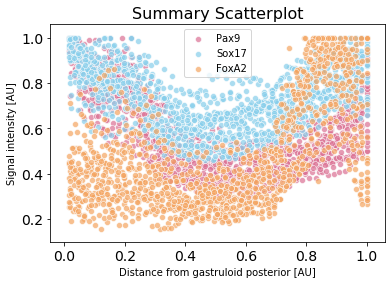

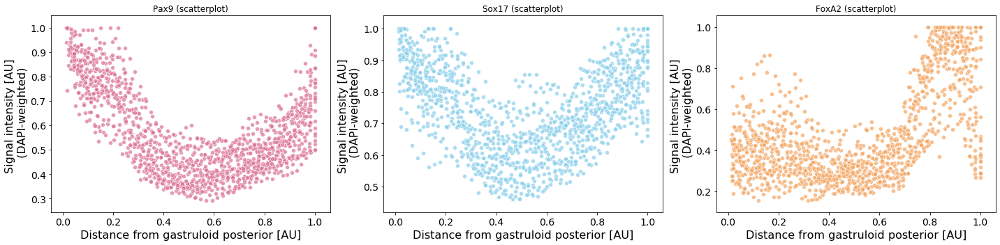

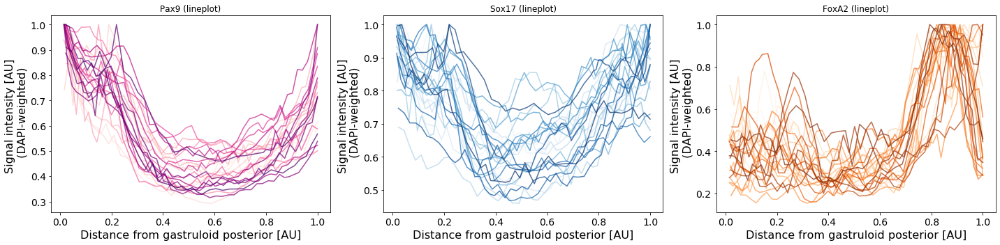

100%|██████████| 4/4 [02:25<00:00, 36.41s/it]


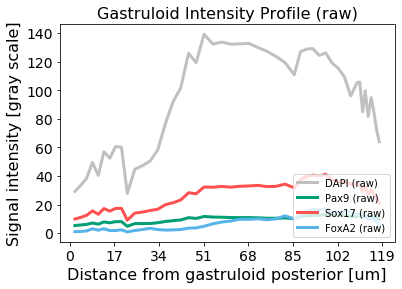

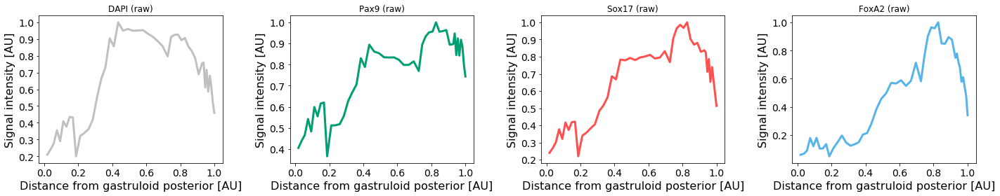

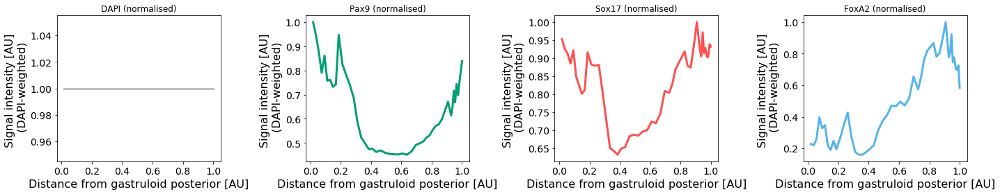

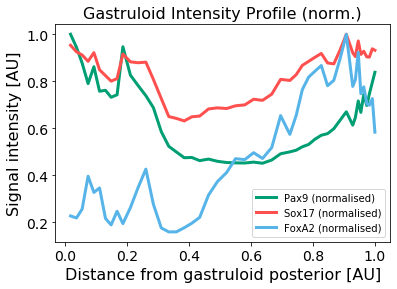

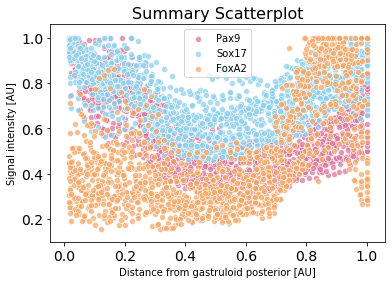

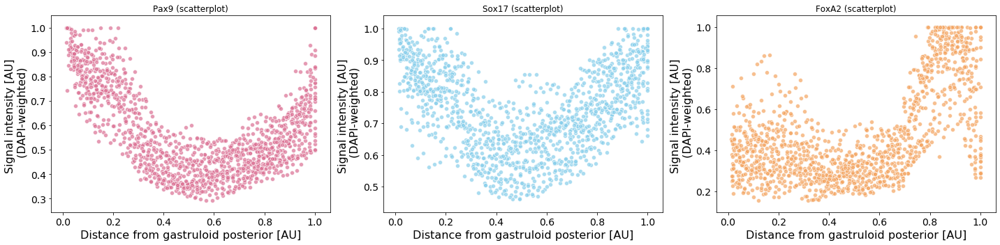

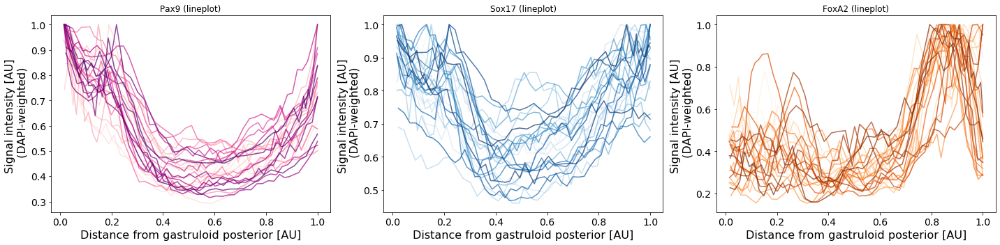

100%|██████████| 4/4 [02:25<00:00, 36.36s/it]


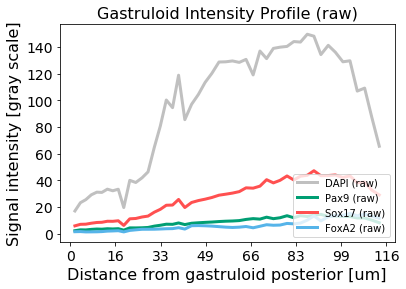

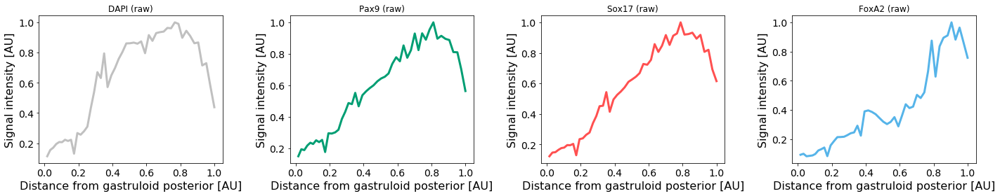

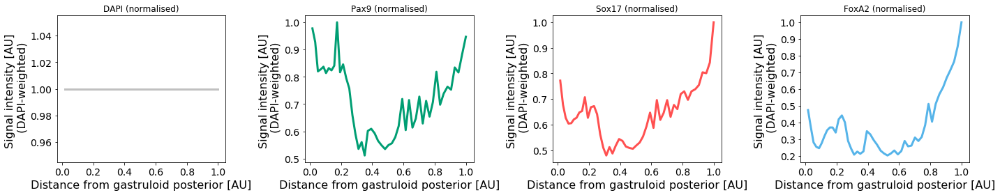

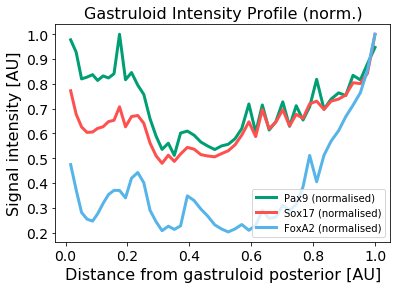

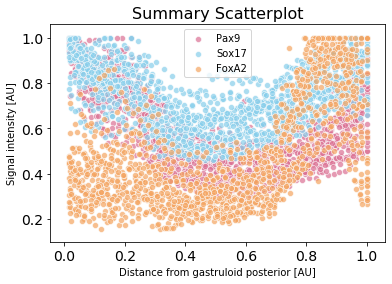

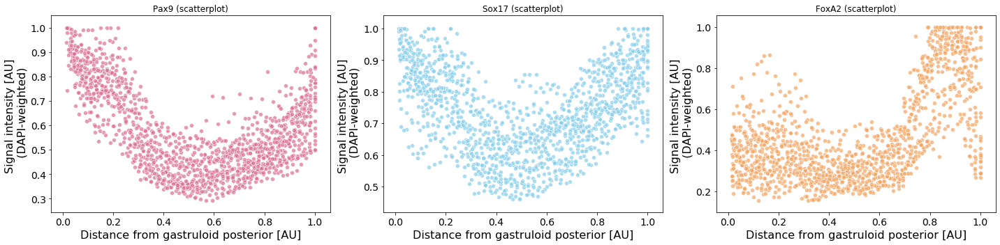

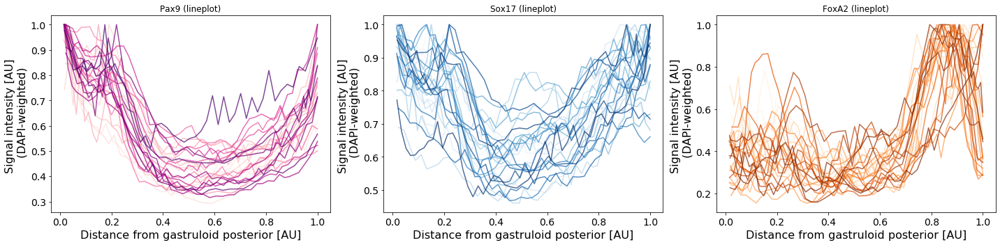

100%|██████████| 4/4 [02:28<00:00, 37.01s/it]


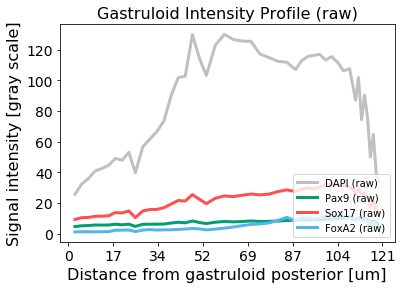

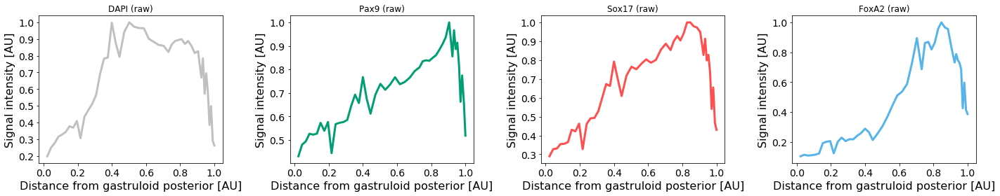

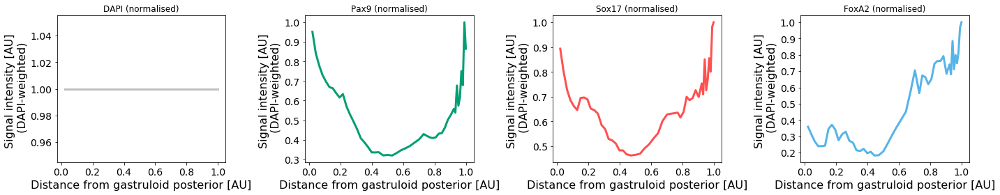

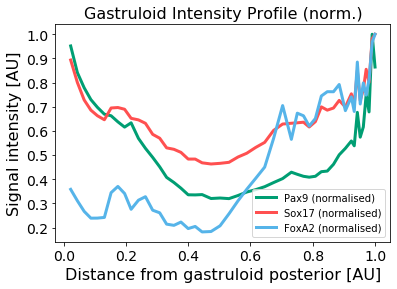

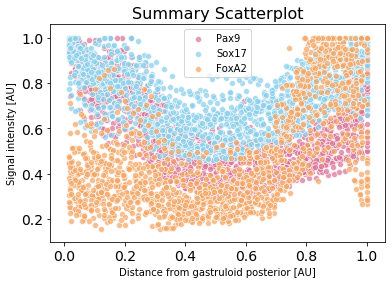

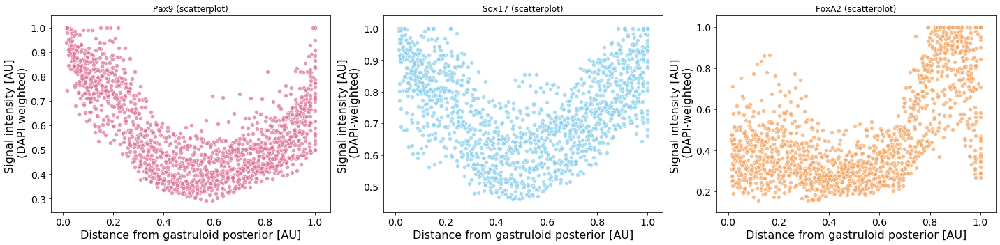

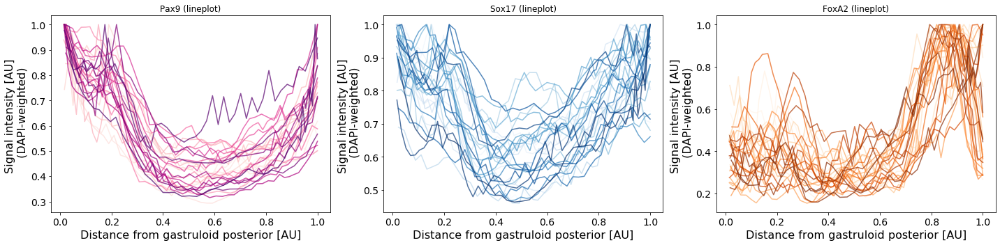

100%|██████████| 4/4 [02:42<00:00, 40.64s/it]


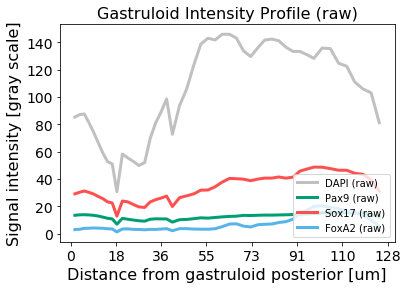

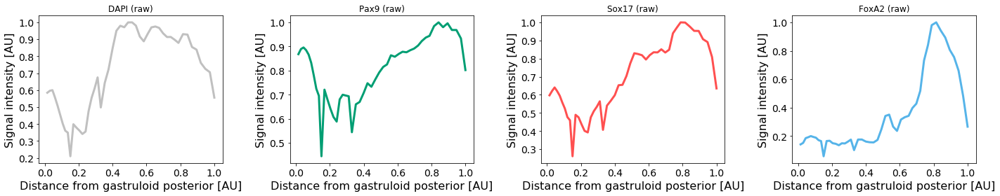

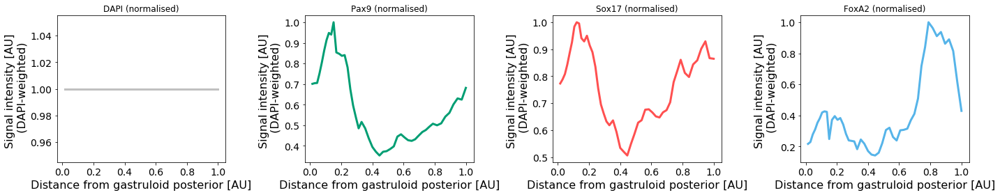

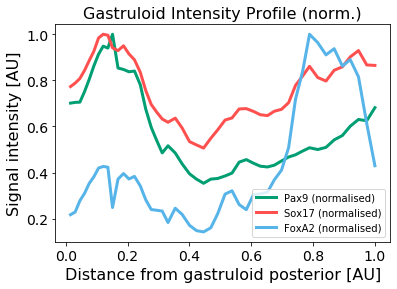

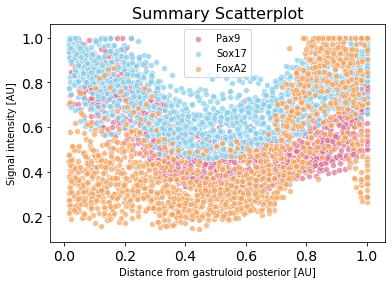

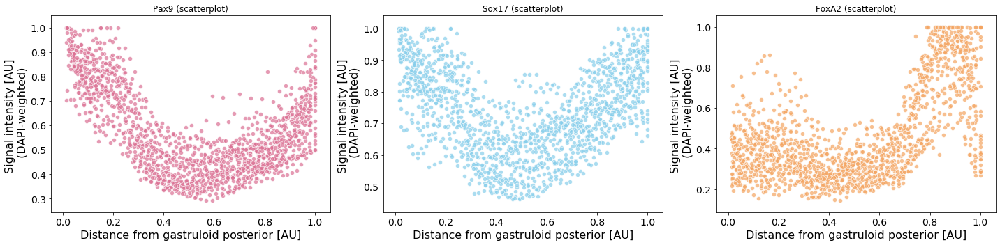

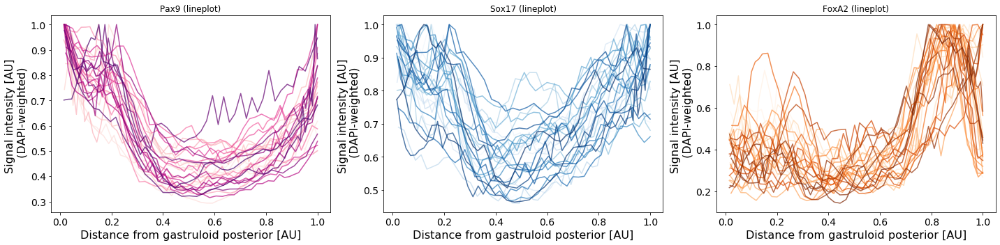

In [8]:
#----------------------------------------------------
# QUANTIFY AND PLOT SIGNAL INTENSITIES
#----------------------------------------------------

# initialise the loop
loop = 0
# start looping through every single ROI provided (i.e. run the quantification code for every sample)
for loop in range(0,(len(roi_files))):
    roi_n = loop

    #----------------------------------------------------
    # QUANTIFY AND PLOT SIGNAL INTENSITIES
    #----------------------------------------------------
    # extract the ROIs provided
    rois = read_roi_file(roi_files[roi_n])
    # Read the names of each ROI
    name_rois = list(rois.keys())
    # Find the number of nodes in each ROI
    roi_points = len(rois[name_rois[0]]['x'])
    # Initialize where to save the coordinates
    x_coords = np.array(rois[name_rois[0]]['x'])
    y_coords = np.array(rois[name_rois[0]]['y'])

    # Uncomment this chunk of code if you want a plot of the ROI
    # ----------------------------------------------------------
    # Plotting a visual representation of the line ROI
    #plt.plot(x_pixel*x_coords, y_pixel*y_coords, color='blue')
    #plt.title('ROI', fontsize = 18)
    #plt.xlabel(r'X [$\mu$m]', fontsize=16) 
    #plt.yticks(fontsize=14)
    #plt.ylabel(r'Y [$\mu$m]', fontsize=16)
    #plt.tight_layout()
    #plt.show()

    #----------------------------------------------------
    # FILL IN BETWEEN NODES WITH ADDITIONAL POINTS
    #----------------------------------------------------
    # Define a custom function, "getEquidistantPoints"
    # this function divides the interval between two nodes into X ("parts") number of evenly spaced subpoints
    def getEquidistantPoints(p1, p2, parts):
        return zip(np.linspace(p1[0], p2[0], parts+1), np.linspace(p1[1], p2[1], parts+1))
    # create empty list of x coordinates of equidistant points
    x_equidist = []
    # create empty list of y coordinates of equidistant points
    y_equidist = []
    # set number of points to fill in (the "parts" argument of the function)
    n_points = 10 #---------------------------------------------------- CHANGE BASED ON YOUR NEEDS
    # Read the x and y coordinates of the first node of the ROI
    x = x_coords.astype(int)
    y = y_coords.astype(int)
    # initialise a temporary list of x coordinates of the subpoints that are being filled in
    x_aux = []
    # initialise a temporary list of y coordinates of the subpoints that are being filled in
    y_aux = []
    # Calculate the coordinates of the subpoints in between each pair of ROI nodes
    for j in range(roi_points-1):
        # use custom function to divide into equally spaced subpoints
        aux = list(getEquidistantPoints((x[j],y[j]),(x[j+1],y[j+1]), n_points))
        # For each of the inserted subpoints, record the coordinates into the temporary lists
        for k in range(len(aux)-1):
            x_aux.append(aux[k][0])
            y_aux.append(aux[k][1])
    # add these newly calculated coordinates to the final list
    x_equidist.append(x_aux)
    y_equidist.append(y_aux)
    # output final list of all coordinates of all points
    x_equidist = np.array(x_equidist[0])
    y_equidist = np.array(y_equidist[0])

    # Uncomment this chunk of code if you want a plot of the ROI nodes + filled-in subpoints
    # ----------------------------------------------------------
    #plt.scatter(x_pixel*x_coords, y_pixel*y_coords, c='blue', s=10)
    #plt.scatter(x_pixel*np.array(x_equidist), y_pixel*np.array(y_equidist), c='orange', s=10, alpha=0.2)
    #plt.title('ROI, with added fill in points', fontsize = 18)
    #plt.xlabel(r'X [$\mu$m]', fontsize=16) 
    #plt.yticks(fontsize=14)
    #plt.ylabel(r'Y [$\mu$m]', fontsize=16)
    #plt.tight_layout()
    #plt.show()

    # Uncomment this chunk of code if you want an overlay of the ROI on the Gastruloid
    # ----------------------------------------------------------
    #plt.figure(figsize=[8,8])
    #plt.title('Processed Gastruloid', fontsize = 18)
    #plt.imshow(im[0], interpolation='nearest', aspect='auto', vmax=100)
    #plt.scatter(x_equidist,y_equidist, s=10, c='red', alpha=0.3)
    #plt.scatter(x_equidist[0],y_equidist[0], s=100, c='white')
    #plt.xticks([])
    #plt.yticks([])

    #----------------------------------------------------
    # EXPAND THE LINE THICKNESS
    #----------------------------------------------------
    # Define a custom function, "binningMask"
    # This function 
    def binningMask(x_all, y_all, N, I):
        # Extract the number of points in segmented line
        length_segmented_line = len(x_all)
        # Initialise an empty list to collect the mean values from the binning mask
        mean_vals = [] 
        # Make an empty array with same dimensions as my image
        width = np.shape(I)[1]
        height = np.shape(I)[0]
        # Initialise an empty mask on the whole image, with all "0"s
        mask_finale = np.zeros((height, width))
        # for every point of the filled-in ROI
        for j in range(1,length_segmented_line-1):
            # Find two consecutive points in the segmented line
            # extract the coordinates of one point
            x = x_all[j]
            y = y_all[j]
            # extract the coordinates of the point before
            x_previous = x_all[j-1]
            y_previous = y_all[j-1]
            # extract the coordinates of the point after
            x_next = x_all[j+1]
            y_next = y_all[j+1]
            # Calculate the distance from the point before 
            dx_previous = x-x_previous
            dy_previous = y-y_previous
            # Calculate the distance from the point after
            dx_next = x-x_next
            dy_next = y-y_next
            # Calculate eucledian distance from the point before
            dist_previous = np.sqrt(dx_previous**2 + dy_previous**2)
            # Calculate eucledian distance from the point after
            dist_next = np.sqrt(dx_next**2 + dy_next**2)
            # Find sine and cosine of the "complementary angle"(pink dot in figure above)
            dx_previous /= dist_previous ## (-)sin of complementary angle
            dy_previous /= dist_previous ## (-)cos of complementary angle
            dx_next /= dist_next ## sin of complementary angle
            dy_next /= dist_next ## cos of complementary angle
            # Find a equidistant point between the point and the one before
            x_middle_previous = (x+x_previous)/2
            y_middle_previous = (y+y_previous)/2
            # Find a equidistant point between the point and the one after
            x_middle_next = (x+x_next)/2
            y_middle_next = (y+y_next)/2
            # Find the coordinates of points at distance N/2 (each half of the band),
            px1 = x_middle_previous + (N/2)*dy_previous # px1 = x - distance*cos(theta: compl.angle)
            px2 = x_middle_previous - (N/2)*dy_previous # px2 = x + distance*cos(theta: compl.angle)
            py1 = y_middle_previous - (N/2)*dx_previous # py1 = y - distance*sin(theta: compl.angle)
            py2 = y_middle_previous + (N/2)*dx_previous # py2 = y + distance*sin(theta: compl.angle)
            px3 = x_middle_next + (N/2)*dy_next
            px4 = x_middle_next - (N/2)*dy_next
            py3 = y_middle_next - (N/2)*dx_next
            py4 = y_middle_next + (N/2)*dx_next
            # Create the 2D polygon that has these points as vertices
            polygon = [px1,py1,px2,py2,px3,py3,px4,py4] 
            # Fill the area of the polygon with values "1", and the rest with 0
            img = Image.new('L', (width, height), 0)
            ImageDraw.Draw(img).polygon(polygon, outline=1, fill=1)
            mask = np.array(img)
            # update the original empty mask
            mask_finale += mask*(j+1)
            # Save the mean values from the mask
            mean_vals.append(np.sum(I*mask)/np.sum(mask))

        return np.array(mean_vals), mask_finale

    ## Run the custom function on the data
    # initialise empty list of recorded mean signal intensities
    intensities = []
    # Loop custom function through each channel and measure mean intensities (also shows progress bar)
    for i in tqdm(range(channels), position=0, leave=True):
        # extract all x coordinates of the points in the line ROI
        x_all = np.array(x_equidist).astype(int)
        # extract all y coordinates of the points in the line ROI
        y_all = np.array(y_equidist).astype(int)
        # extract the current channel
        I = im[i]
        # feed all of these values to the custom function
        # this outputs the thick line mask, and a list of mean intensities for each channel
        intensities_i, mask_finale = binningMask(x_all, y_all, N, I)
        # update the list of mean intensities with the intensities measured in the current channel
        intensities.append(intensities_i)

    # Uncomment the line below if you want to see the mask applied
    # ----------------------------------------------------------
    #plt.imshow(mask_finale, cmap='jet')


    #----------------------------------------------------
    # PLOT VALUES FOR SINGLE ROIs (SINGLE SAMPLES)
    #----------------------------------------------------
    # define the path to the pdf where all pdf output will be saved
    pdf = PdfPages('%s/Results_ROI%.3d.pdf'%(output_path, roi_n+1))
    
    ## CALCULATE ALL DISTANCES (X VALUES)
    ################################################################
    # initialise an empty list to store x values
    distances = []
    # extract all x coordinates of the points in the line ROI
    x_all = np.array(x_equidist).astype(int)
    # extract all y coordinates of the points in the line ROI
    y_all = np.array(y_equidist).astype(int)
    # Set the origin as the first coordinate pair, in my case, the most posterior part of the tail
    x_origin = x_all[0]
    y_origin = y_all[0]
    # initialise a temporary empty list of further points to add
    aux_dist = []
    # for every point of the line, record the euclidean distance from the previous point
    for j in range(1,len(x_all)):
        aux_dist.append(np.sqrt((x_all[j]-x_all[j-1])**2+(y_all[j]-y_all[j-1])**2))
    
    # Save the distances
    distances.append(np.cumsum(aux_dist))

    ## PLOT RAW INTENSITIES TOGETHER (AGAINST ABSOLUTE GASTRULOID LENGTH) 
    ################################################################
    # set list of colors to use
    # For more colors, check : https://matplotlib.org/3.1.1/tutorials/colors/colors.html
    colors = ['#C0C0C0', '#009E73', '#ff5050', '#56B4E9']
    # set list of labels for each channel
    labels = pd.Series([ch1_label, ch2_label, ch3_label, ch4_label])
    # set list of titles for each plot
    titles = labels + " (raw)"
    # initialise figure
    fig_roi_raw_all = plt.figure(figsize=[6,4])
    # for each channel, plot the corresponding trace in the plot
    for i in range(channels):
        plt.plot(distances[0][:-1], intensities[i], linewidth=3, color=colors[i], label=titles[i])
    # set plot parameters
    plt.title('Gastruloid Intensity Profile (raw)', fontsize=16)
    plt.xlabel('Distance from gastruloid posterior [um]', fontsize=16)
    plt.ylabel('Signal intensity [gray scale]', fontsize=16)
    plt.xticks(np.linspace(1,max(distances[0]),8), map(int,np.linspace(0,max(distances[0]),8)*x_pixel), fontsize=14);
    plt.yticks(fontsize=14);
    plt.legend(loc="lower right")
    # save the plot
    pdf.savefig(fig_roi_raw_all)
    
    ## PLOT RAW INTENSITIES SEPARATE (AGAINST NORMALISED GASTRULOID LENGTH) 
    ################################################################
    # set list of colors to use
    colors = ['#C0C0C0', '#009E73', '#ff5050', '#56B4E9']
    # set list of labels for each channel
    labels = pd.Series([ch1_label, ch2_label, ch3_label, ch4_label])
    # set list of titles for each plot
    titles = labels + " (raw)"
    # initialise figure
    fig_roi_raw_separated = plt.figure(figsize=[20,4])
    # for each channel, plot the corresponding plot in the figure
    for i in range(channels):
        plt.subplot(1,channels,i+1).title.set_text(titles[i])
        plt.plot(distances[0][:-1]/max(distances[0][:-1]), intensities[i]/max(intensities[i]), linewidth=3, color=colors[i])
        # set plot parameters
        plt.xlabel('Distance from gastruloid posterior [AU]', fontsize=16)
        plt.ylabel('Signal intensity [AU]', fontsize=16)
        plt.xticks( fontsize=14);
        plt.yticks(fontsize=14);
    # fit plots in the figure
    plt.tight_layout()
    # keep plots visible
    plt.show()
    # save the figure with all plots
    pdf.savefig(fig_roi_raw_separated)
    
    ## PLOT DAPI-NORMALISED INTENSITIES SEPARATE (AGAINST NORMALISED GASTRULOID LENGTH) 
    ################################################################
    # set list of colors to use
    colors = ['#C0C0C0', '#009E73', '#ff5050', '#56B4E9']
    # set list of titles for each plot
    titles = titles = labels + " (normalised)"
    # initialise figure
    fig_roi_normalised_separated = plt.figure(figsize=[20,4])
    # for each channel, plot the corresponding plot in the figure
    for i in range(channels):
        plt.subplot(1,channels,i+1).title.set_text(titles[i])
        plt.plot(distances[0][:-1]/max(distances[0][:-1]), (intensities[i]/intensities[0])/max(intensities[i]/intensities[0]), linewidth=3, color=colors[i])
        # set plot parameters
        plt.xlabel('Distance from gastruloid posterior [AU]', fontsize=16)
        plt.ylabel('Signal intensity [AU] \n (DAPI-weighted)', fontsize=16)
        plt.xticks( fontsize=14);
        plt.yticks(fontsize=14);
    # fit plots in the figure
    plt.tight_layout()
    # keep plots visible
    plt.show()
    # save the figure with all plots
    pdf.savefig(fig_roi_normalised_separated)

    ## PLOT DAPI-NORMALISED INTENSITIES TOGETHER (AGAINST NORMALISED GASTRULOID LENGTH) 
    ################################################################
    # set list of colors to use
    colors = ['#C0C0C0', '#009E73', '#ff5050', '#56B4E9']
    # set list of titles for each plot
    titles = titles = labels + " (normalised)"
    # initialise figure
    fig_roi_normalised_all = plt.figure(figsize=[6,4])
    # for each channel, plot the corresponding data on the plot
    for i in range(channels):
        if i == 0 : ## to avoid plotting the first channel (DAPI, normalised to 1)
            i== i+1 
        else: ##i.e. for all other channels
            plt.plot(distances[0][:-1]/max(distances[0][:-1]), (intensities[i]/intensities[0])/max(intensities[i]/intensities[0]), linewidth=3, color=colors[i], label=titles[i])
    # set plot parameters
    plt.title('Gastruloid Intensity Profile (norm.)', fontsize=16)
    plt.xlabel('Distance from gastruloid posterior [AU]', fontsize=16)
    plt.ylabel('Signal intensity [AU]', fontsize=16)
    plt.xticks( fontsize=14);
    plt.yticks(fontsize=14);
    plt.legend(loc="lower right")
    # keep plot visible
    plt.show()
    # save the figure with the plot
    pdf.savefig(fig_roi_normalised_all)
    # close the pdf document
    pdf.close()

    #----------------------------------------------------
    # PLOT THE CUMULATIVE SCATTERPLOT
    #----------------------------------------------------
    # define the path to the pdf where all pdf output will be saved
    pdf = PdfPages('%s/Results_Combined_TIF%.3d.pdf'%(output_path, file_n+1))

    ## SAVE THE DATA ACCUMULATED FOR THIS ROI (SAMPLE), IN A DATAFRAME 
    ################################################################
    # for tidy format, need a column with sample ID (ROI number)
    # this will be repeated for every line there is data available
    data_roi = [roi_n]*(len((distances[0][:-1]/max(distances[0][:-1]))))
    # store this list of IDs in "roi" column of new dataframe
    data_sample = pd.DataFrame({"roi":data_roi})
    # extract x-axis values (distances from posterior)
    data_x = (distances[0][:-1]/max(distances[0][:-1]))
    # store values in "x" column of new dataframe
    data_x = pd.DataFrame({"x":data_x})
    # extract y-axis values (measured intensities), for every channel
    data_y = pd.DataFrame({})
    for i in range(channels):
        if i == 0 : ## to avoid plotting the first channel (DAPI, normalised to 1)
            i== i+1 
        else: ##i.e. for all other channels
            data_y[i] = (intensities[i]/intensities[0]/max(intensities[i]/intensities[0]))
    # store all collected data into a new dataframe called "data_all"
    data_all = pd.concat([data_sample, data_x, data_y], axis=1)
    
    ## ADD THE DATA COLLECTED FOR THIS SAMPLE, TO THE DATA COLLECTED FOR PREVIOUS ONES 
    ################################################################
    # append the data generated in this loop ("data_all") to a permanent summary dataframe ("data_collated")
    data_collated = pd.concat([data_collated, data_all], join='inner')
    
    ## PLOT SCATTERPLOT OF ALL DATA COLLECTED UP TO CURRENT LOOP
    ################################################################
    # set list of colors to use
    colors = ["gray", 'palevioletred', 'skyblue', 'sandybrown']
    # set list of titles for each plot
    titles = labels
    # for each channel, plot the corresponding data on the plot
    for i in range(channels):
        if i == 0 : ## to avoid plotting the first channel (DAPI, normalised to 1)
            i== i+1 
        else: ##i.e. for all other channels
            final_plot = sns.scatterplot("x", i, data=data_collated, alpha=0.7, color=colors[i], label=titles[i])
    # set plot parameters
    plt.title('Summary Scatterplot', fontsize=16)
    plt.xlabel('Distance from gastruloid posterior [AU]', fontsize=10)
    plt.ylabel('Signal intensity [AU]', fontsize=10)
    plt.xticks( fontsize=14);
    plt.yticks(fontsize=14);
    # save the figure with the plot
    fig_mainscatterplot = final_plot.get_figure()
    pdf.savefig(fig_mainscatterplot)

    ## PLOT SEPARATE SCATTERPLOTS FOR EACH CHANNEL, OF ALL DATA COLLECTED UP TO CURRENT LOOP
    ################################################################
    # set list of colors to use
    colors = ["gray", 'palevioletred', 'skyblue', 'sandybrown']
    # set list of titles for each plot
    titles = labels+ " (scatterplot)"
    # initialise figure
    fig_scatterplots = plt.figure(figsize=[20,5])
    # for each channel, add the corresponding plot in the figure
    for i in range(channels):
        if i == 0 : ## to avoid plotting the first channel (DAPI, normalised to 1)
            i== i+1 
        else: ##i.e. for all other channels
            plt.subplot(1,channels-1,i).title.set_text(titles[i])
            sns.scatterplot("x", i, data=data_collated, alpha=0.7, color=colors[i])
            # set plot parameters
            plt.xlabel('Distance from gastruloid posterior [AU]', fontsize=16)
            plt.ylabel('Signal intensity [AU] \n (DAPI-weighted)', fontsize=16)
            plt.xticks( fontsize=14);
            plt.yticks(fontsize=14);
    # fit plots in the figure
    plt.tight_layout()
    # keep plots visible
    plt.show()
    # save the figure with the plots
    pdf.savefig(fig_scatterplots)

    ## PLOT SEPARATE LINEPLOTS FOR EACH CHANNEL, OF ALL DATA COLLECTED UP TO CURRENT LOOP
    ################################################################
    # set list of palettes to use for different samples within same plot
    palettes = ["Grays", "RdPu", "Blues", "Oranges"]
    # set list of titles for each plot
    titles = labels+ " (lineplot)"
    # initialise figure    
    fig_lineplots = plt.figure(figsize=[20,5])
    # for each channel, add the corresponding plot in the figure
    for i in range(channels):
        if i == 0 : ## to avoid plotting the first channel (DAPI, normalised to 1)
            i== i+1 
        else: ##i.e. for all other channels
            plt.subplot(1,channels-1,i).title.set_text(titles[i])
            sns.lineplot("x", i, data=data_collated, alpha=0.7, hue="roi", palette=palettes[i]).legend_.remove()
            # set plot parameters
            plt.xlabel('Distance from gastruloid posterior [AU]', fontsize=16)
            plt.ylabel('Signal intensity [AU] \n (DAPI-weighted)', fontsize=16)
            plt.xticks( fontsize=14);
            plt.yticks(fontsize=14);
    # fit plots in the figure
    plt.tight_layout()
    # keep plots visible
    plt.show()
    # save the figure with the plots
    pdf.savefig(fig_lineplots)
    # close pdf document
    pdf.close()
    
    # loop this whole cell back to the top, to process the next ROI (the next sample)
    loop = loop+1

__Note:__ if the code above gives an error about indeces, make sure your tif file only has 4 channels (i.e. does __not__ include the BF channel)

In [9]:
#-------------------------------------------------------------
# RUN TO EXPORT THE COLLECTIVE DATA FOR THE PLOTS ABOVE
#-------------------------------------------------------------

data_collated.to_csv(os.path.join(output_path,r'Data_table.csv'))


## Plot tweaking and Customisation

In [2]:
from tkinter import Tk     # from tkinter import Tk for Python 3.x
from tkinter.filedialog import askopenfilename

Tk().withdraw() # we don't want a full GUI, so keep the root window from appearing
data_path = askopenfilename() # show an "Open" dialog box and return the path to the selected file

df = pd.read_csv(data_path,index_col=0)
df

,roi,x,1,2,3
0,0.0,0.019796,1.000000,1.000000,0.579759
1,0.0,0.039592,0.878130,0.913369,0.512186
2,0.0,0.060182,0.811096,0.935270,0.654808
3,0.0,0.079978,0.778510,0.889046,0.616300
4,0.0,0.100567,0.757418,0.861964,0.587710
...,...,...,...,...,...
43,29.0,0.894828,0.560645,0.858737,0.861832
44,29.0,0.920247,0.600985,0.901663,0.889906
45,29.0,0.946906,0.630268,0.929215,0.814980
46,29.0,0.973564,0.624476,0.866859,0.612669


In [5]:
# set list of colors to use
#colors = ['gray', 'gray', 'gray']
colors = ['sandybrown', 'violet', 'skyblue']
# set list of titles for each plot
titles = ["Pax9","Sox17","FoxA2"]

In [6]:
plt.style.use("dark_background")
#plt.style.use("default")

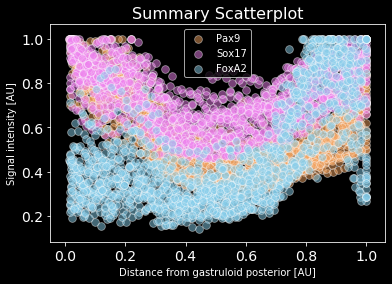

In [7]:
for i in [1,2,3]:
        final_plot = sns.scatterplot("x", str(i), data=df, alpha=0.5, color=colors[i-1], label=titles[i-1], s=60)
        # set plot parameters
        plt.title('Summary Scatterplot', fontsize=16)
        plt.xlabel('Distance from gastruloid posterior [AU]', fontsize=10)
        plt.ylabel('Signal intensity [AU]', fontsize=10)
        plt.xticks( fontsize=14);
        plt.yticks(fontsize=14)

        
        

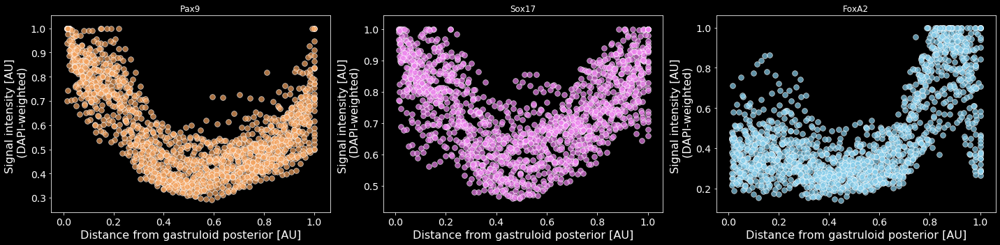

In [8]:
fig_scatterplots = plt.figure(figsize=[20,5])

for i in [1,2,3]:
    plt.subplot(1,3,i).title.set_text(titles[i-1])
    sns.scatterplot("x", str(i), data=df, alpha=0.7, color=colors[i-1], s=60)
    # set plot parameters
    plt.xlabel('Distance from gastruloid posterior [AU]', fontsize=16)
    plt.ylabel('Signal intensity [AU] \n (DAPI-weighted)', fontsize=16)
    plt.xticks( fontsize=14);
    plt.yticks(fontsize=14);
    # fit plots in the figure
    plt.tight_layout()

In [9]:
df_sorted = df.sort_values(by=['x'])
#df_sorted

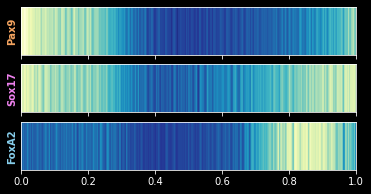

In [11]:
plt.rcParams["figure.figsize"] = 6,1
fig, (ax1, ax2, ax3) = plt.subplots(nrows=3, sharex=True)

colormaps = ["YlGnBu_r", "YlGnBu_r", "YlGnBu_r"]
#colormaps = ["Blues", "Oranges", "RdPu"]
#colormaps = ["Greys_r", "Greys_r", "Greys_r"]

labels =["Pax9","Sox17","FoxA2"]
label_colors = ['sandybrown', 'violet', 'skyblue']

x = df_sorted["x"]

extent = [0,1,0,1]
y = df_sorted["1"]
ax1.imshow(y[np.newaxis,:], cmap=colormaps[0], aspect="auto", extent=extent, interpolation="bicubic")
ax1.set_yticks([])
ax1.set_ylabel(labels[0], fontweight='bold')
ax1.yaxis.label.set_color(label_colors[0])
ax1.set_xlim(extent[0], extent[1])

y = df_sorted["2"]
ax2.imshow(y[np.newaxis,:], cmap=colormaps[1], aspect="auto", extent=extent, interpolation="bicubic")
ax2.set_yticks([])
ax2.set_ylabel(labels[1], fontweight='bold')
ax2.yaxis.label.set_color(label_colors[1])
ax2.set_xlim(extent[0], extent[1])

y = df_sorted["3"]
ax3.imshow(y[np.newaxis,:], cmap=colormaps[2], aspect="auto", extent=extent, interpolation="bicubic")
ax3.set_yticks([])
ax3.set_ylabel(labels[2], fontweight='bold')
ax3.yaxis.label.set_color(label_colors[2])
ax3.set_xlim(extent[0], extent[1])

fig.set_figheight(3)